In [1]:
import numpy as np
import pandas as pd # pre-processing data
import yfinance as yf # get price & volume
from numpy import mat 
from sklearn import preprocessing # standardize the data
import matplotlib.pyplot as plt #draw graph
%matplotlib inline

# 原始各公司每季財報

In [2]:
csv_file = r"C:財務報表.csv" ##財務報表檔案路徑
data_fr_raw = pd.read_csv(csv_file, encoding= 'unicode_escape')
data_fr_raw ##原始檔案

D:\Anaconda\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (16,18,28,33,34,38,40,41,54,62,64,65,71,72,76,78,88,102,107,114,122,123,124,125,135,140,143,144,145,153,154,155,156,160,162,163,164,165,170,171,172,178,182,183,189,190,192,202,204,205,206,208,212,215,216,217,224,227,241,242,243,244,245,249,254,255,256,264,265,273,274,293,297,303,338,347,348,353,354,355,389,407,409,411,414,415,417,418,437,438,439,440,441,444,477,480,481,482,485,486,489,491,494,495,496,499,501,510,511,512,514,515,516,517,518,521,525,526,529,538,545,547,553,556,557,561,564,567,568,574,576,580,585,587,588,589,591,592,596,597,607,610,611,615,617,618,619,621,623,624,625,627,629,630,631,632,634,635,637,640,641,642,647,648,651,652,654,655,656,658,659,660,661,662,663,664,665,666,668,669,670,671,672,673,674,676,677,678,679,680,681,682,683,684,689,690,691,699,705,706,707,708,709,719,720,721,722,723,742,750,752,754,763,764,765,767,771,772,773,777,778,779,781,782,787) have mixed types.Specify

,CO_ID,YYYYMM,Quarter,consolidation,Month,Currency,Total cash and cash equivalents,Total current financial assets at fair value through profit or loss,Financial assets at fair value through other comprehensive income - Current,Financial assets measured at amortized cost - Current,...,Date of preparation of financial statements,Financial Report Type (1.Individual 2. Parent Company Only 3.Consolidated),Fiscal Year Start Date,Fiscal Year End Date,Market,TSE Industry ID,TSE Sub Industry ID,TEJ Industry ID,TEJ Sub Industry ID,Financial Statements Reviewed by TEJ Y/N
0,2330 TSMC,2020/12/31,4,Y,12,NTD,"660,170,647","2,259,412","122,448,453","6,597,992",...,2021/2/26,3,2020/01,2020/12,TSE,M2300,M2324,23G,23G1A,Y
1,2317 Hon Hai Precision,2020/12/31,4,Y,12,NTD,"1,232,794,015","6,285,594",0,"38,783,566",...,2021/3/30,3,2020/01,2020/12,TSE,M2300,M2331,23A,23A1,Y
2,2454 MediaTek,2020/12/31,4,Y,12,NTD,"196,579,745","8,504,707","4,373,488","655,356",...,2021/3/30,3,2020/01,2020/12,TSE,M2300,M2324,23G,23G5,Y
3,2603 Evergreen Marine,2020/12/31,4,Y,12,NTD,"44,096,485","4,289",0,"6,768,603",...,2021/3/23,3,2020/01,2020/12,TSE,M2600,M2600,26A,26A2,Y
4,6505 Formosa Petrochem.,2020/12/31,4,Y,12,NTD,"42,965,803","3,888,511","61,996,861",0,...,2021/3/11,3,2020/01,2020/12,TSE,M9700,M9700,13C,13C,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5495,9910 Feng Tay,2021/3/31,1,Y,3,NTD,"4,615,874",0,0,0,...,2021/5/11,3,2021/01,2021/03,TSE,M9900,M9900,99K,99K,Y
5496,9914 Merida,2021/3/31,1,Y,3,NTD,"3,649,536","1,219,189",0,0,...,2021/5/14,3,2021/01,2021/03,TSE,M9900,M9900,99Z,99Z1,Y
5497,9921 Giant,2021/3/31,1,Y,3,NTD,"9,149,497","3,485,127",0,"154,522",...,2021/5/13,3,2021/01,2021/03,TSE,M9900,M9900,99Z,99Z1,Y
5498,9941 YFC,2021/3/31,1,Y,3,NTD,"8,851,961","83,943",0,"855,635",...,2021/5/13,3,2021/01,2021/03,TSE,M9900,M9900,28K,28K,Y


In [3]:
##YYYYMM 轉 DateTime
data_fr_raw['YYYYMM'] = pd.to_datetime(data_fr_raw['YYYYMM'])

In [4]:
##把相同公司按照時間排序在一起(100間 * 55季(2008-2021 Q2)
##排序方式: 公司代碼由小到大，時間由 2021第三季到 2008第一季
##時間只選到 2008 因為2008前有很多公司不是季報
data_fr_temp = pd.DataFrame()
data_fr_temp = data_fr_raw.sort_values(by=['CO_ID','YYYYMM'], ascending=[True,False],ignore_index=True)
data_fr_temp

,CO_ID,YYYYMM,Quarter,consolidation,Month,Currency,Total cash and cash equivalents,Total current financial assets at fair value through profit or loss,Financial assets at fair value through other comprehensive income - Current,Financial assets measured at amortized cost - Current,...,Date of preparation of financial statements,Financial Report Type (1.Individual 2. Parent Company Only 3.Consolidated),Fiscal Year Start Date,Fiscal Year End Date,Market,TSE Industry ID,TSE Sub Industry ID,TEJ Industry ID,TEJ Sub Industry ID,Financial Statements Reviewed by TEJ Y/N
0,1101 Taiwan Cement,2021-09-30,3,Y,9,NTD,"59,958,809","335,314","6,180,994","15,157,115",...,2021/11/11,3,2021/01,2021/09,TSE,M1100,M1100,11A,11A,Y
1,1101 Taiwan Cement,2021-06-30,2,Y,6,NTD,"63,835,177","362,554","6,097,715","7,593,330",...,2021/8/12,3,2021/01,2021/06,TSE,M1100,M1100,11A,11A,Y
2,1101 Taiwan Cement,2021-03-31,1,Y,3,NTD,"58,958,539","344,694","5,721,861","9,459,089",...,2021/5/12,3,2021/01,2021/03,TSE,M1100,M1100,11A,11A,Y
3,1101 Taiwan Cement,2020-12-31,4,Y,12,NTD,"51,433,522","353,986","5,596,471","15,769,277",...,2021/3/19,3,2020/01,2020/12,TSE,M1100,M1100,11A,11A,Y
4,1101 Taiwan Cement,2020-09-30,3,Y,9,NTD,"44,312,180","323,517","5,168,519","12,348,988",...,2020/11/10,3,2020/01,2020/09,TSE,M1100,M1100,11A,11A,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5495,9945 Ruentex Develop,2009-03-31,1,Y,3,NTD,"2,504,475","103,664",0,"6,000",...,2009/5/15,3,2009/01,2009/03,TSE,M9900,M9900,25A,25A,Y
5496,9945 Ruentex Develop,2008-12-31,4,Y,12,NTD,"4,145,874","103,528",0,"6,000",...,2009/4/17,3,2008/01,2008/12,TSE,M9900,M9900,25A,25A,Y
5497,9945 Ruentex Develop,2008-09-30,3,Y,9,NTD,"3,841,387","103,125",0,"1,000",...,2008/11/13,3,2008/01,2008/09,TSE,M9900,M9900,25A,25A,Y
5498,9945 Ruentex Develop,2008-06-30,2,Y,6,NTD,"2,886,498","107,582",0,"1,000",...,2008/9/10,3,2008/01,2008/06,TSE,M9900,M9900,25A,25A,Y


In [5]:
##drop 2021第三季
data_fr = data_fr_temp.drop(data_fr_temp[data_fr_temp['YYYYMM']=='2021/9/30'].index)
data_fr

,CO_ID,YYYYMM,Quarter,consolidation,Month,Currency,Total cash and cash equivalents,Total current financial assets at fair value through profit or loss,Financial assets at fair value through other comprehensive income - Current,Financial assets measured at amortized cost - Current,...,Date of preparation of financial statements,Financial Report Type (1.Individual 2. Parent Company Only 3.Consolidated),Fiscal Year Start Date,Fiscal Year End Date,Market,TSE Industry ID,TSE Sub Industry ID,TEJ Industry ID,TEJ Sub Industry ID,Financial Statements Reviewed by TEJ Y/N
1,1101 Taiwan Cement,2021-06-30,2,Y,6,NTD,"63,835,177","362,554","6,097,715","7,593,330",...,2021/8/12,3,2021/01,2021/06,TSE,M1100,M1100,11A,11A,Y
2,1101 Taiwan Cement,2021-03-31,1,Y,3,NTD,"58,958,539","344,694","5,721,861","9,459,089",...,2021/5/12,3,2021/01,2021/03,TSE,M1100,M1100,11A,11A,Y
3,1101 Taiwan Cement,2020-12-31,4,Y,12,NTD,"51,433,522","353,986","5,596,471","15,769,277",...,2021/3/19,3,2020/01,2020/12,TSE,M1100,M1100,11A,11A,Y
4,1101 Taiwan Cement,2020-09-30,3,Y,9,NTD,"44,312,180","323,517","5,168,519","12,348,988",...,2020/11/10,3,2020/01,2020/09,TSE,M1100,M1100,11A,11A,Y
5,1101 Taiwan Cement,2020-06-30,2,Y,6,NTD,"59,005,748","492,238","5,392,561","15,741,435",...,2020/8/11,3,2020/01,2020/06,TSE,M1100,M1100,11A,11A,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5495,9945 Ruentex Develop,2009-03-31,1,Y,3,NTD,"2,504,475","103,664",0,"6,000",...,2009/5/15,3,2009/01,2009/03,TSE,M9900,M9900,25A,25A,Y
5496,9945 Ruentex Develop,2008-12-31,4,Y,12,NTD,"4,145,874","103,528",0,"6,000",...,2009/4/17,3,2008/01,2008/12,TSE,M9900,M9900,25A,25A,Y
5497,9945 Ruentex Develop,2008-09-30,3,Y,9,NTD,"3,841,387","103,125",0,"1,000",...,2008/11/13,3,2008/01,2008/09,TSE,M9900,M9900,25A,25A,Y
5498,9945 Ruentex Develop,2008-06-30,2,Y,6,NTD,"2,886,498","107,582",0,"1,000",...,2008/9/10,3,2008/01,2008/06,TSE,M9900,M9900,25A,25A,Y


In [6]:
data_fr = data_fr.reset_index(drop = True) ##重置 index
data_fr

,CO_ID,YYYYMM,Quarter,consolidation,Month,Currency,Total cash and cash equivalents,Total current financial assets at fair value through profit or loss,Financial assets at fair value through other comprehensive income - Current,Financial assets measured at amortized cost - Current,...,Date of preparation of financial statements,Financial Report Type (1.Individual 2. Parent Company Only 3.Consolidated),Fiscal Year Start Date,Fiscal Year End Date,Market,TSE Industry ID,TSE Sub Industry ID,TEJ Industry ID,TEJ Sub Industry ID,Financial Statements Reviewed by TEJ Y/N
0,1101 Taiwan Cement,2021-06-30,2,Y,6,NTD,"63,835,177","362,554","6,097,715","7,593,330",...,2021/8/12,3,2021/01,2021/06,TSE,M1100,M1100,11A,11A,Y
1,1101 Taiwan Cement,2021-03-31,1,Y,3,NTD,"58,958,539","344,694","5,721,861","9,459,089",...,2021/5/12,3,2021/01,2021/03,TSE,M1100,M1100,11A,11A,Y
2,1101 Taiwan Cement,2020-12-31,4,Y,12,NTD,"51,433,522","353,986","5,596,471","15,769,277",...,2021/3/19,3,2020/01,2020/12,TSE,M1100,M1100,11A,11A,Y
3,1101 Taiwan Cement,2020-09-30,3,Y,9,NTD,"44,312,180","323,517","5,168,519","12,348,988",...,2020/11/10,3,2020/01,2020/09,TSE,M1100,M1100,11A,11A,Y
4,1101 Taiwan Cement,2020-06-30,2,Y,6,NTD,"59,005,748","492,238","5,392,561","15,741,435",...,2020/8/11,3,2020/01,2020/06,TSE,M1100,M1100,11A,11A,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5395,9945 Ruentex Develop,2009-03-31,1,Y,3,NTD,"2,504,475","103,664",0,"6,000",...,2009/5/15,3,2009/01,2009/03,TSE,M9900,M9900,25A,25A,Y
5396,9945 Ruentex Develop,2008-12-31,4,Y,12,NTD,"4,145,874","103,528",0,"6,000",...,2009/4/17,3,2008/01,2008/12,TSE,M9900,M9900,25A,25A,Y
5397,9945 Ruentex Develop,2008-09-30,3,Y,9,NTD,"3,841,387","103,125",0,"1,000",...,2008/11/13,3,2008/01,2008/09,TSE,M9900,M9900,25A,25A,Y
5398,9945 Ruentex Develop,2008-06-30,2,Y,6,NTD,"2,886,498","107,582",0,"1,000",...,2008/9/10,3,2008/01,2008/06,TSE,M9900,M9900,25A,25A,Y


In [7]:
# 把資料型態從datetime轉成str
YYYYMM = []
for i in data_fr['YYYYMM']:
    temp_date = str(i)
    YYYYMM.append(temp_date[:10])
data_fr['YYYYMM'] = YYYYMM

In [8]:
data_fr

,CO_ID,YYYYMM,Quarter,consolidation,Month,Currency,Total cash and cash equivalents,Total current financial assets at fair value through profit or loss,Financial assets at fair value through other comprehensive income - Current,Financial assets measured at amortized cost - Current,...,Date of preparation of financial statements,Financial Report Type (1.Individual 2. Parent Company Only 3.Consolidated),Fiscal Year Start Date,Fiscal Year End Date,Market,TSE Industry ID,TSE Sub Industry ID,TEJ Industry ID,TEJ Sub Industry ID,Financial Statements Reviewed by TEJ Y/N
0,1101 Taiwan Cement,2021-06-30,2,Y,6,NTD,"63,835,177","362,554","6,097,715","7,593,330",...,2021/8/12,3,2021/01,2021/06,TSE,M1100,M1100,11A,11A,Y
1,1101 Taiwan Cement,2021-03-31,1,Y,3,NTD,"58,958,539","344,694","5,721,861","9,459,089",...,2021/5/12,3,2021/01,2021/03,TSE,M1100,M1100,11A,11A,Y
2,1101 Taiwan Cement,2020-12-31,4,Y,12,NTD,"51,433,522","353,986","5,596,471","15,769,277",...,2021/3/19,3,2020/01,2020/12,TSE,M1100,M1100,11A,11A,Y
3,1101 Taiwan Cement,2020-09-30,3,Y,9,NTD,"44,312,180","323,517","5,168,519","12,348,988",...,2020/11/10,3,2020/01,2020/09,TSE,M1100,M1100,11A,11A,Y
4,1101 Taiwan Cement,2020-06-30,2,Y,6,NTD,"59,005,748","492,238","5,392,561","15,741,435",...,2020/8/11,3,2020/01,2020/06,TSE,M1100,M1100,11A,11A,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5395,9945 Ruentex Develop,2009-03-31,1,Y,3,NTD,"2,504,475","103,664",0,"6,000",...,2009/5/15,3,2009/01,2009/03,TSE,M9900,M9900,25A,25A,Y
5396,9945 Ruentex Develop,2008-12-31,4,Y,12,NTD,"4,145,874","103,528",0,"6,000",...,2009/4/17,3,2008/01,2008/12,TSE,M9900,M9900,25A,25A,Y
5397,9945 Ruentex Develop,2008-09-30,3,Y,9,NTD,"3,841,387","103,125",0,"1,000",...,2008/11/13,3,2008/01,2008/09,TSE,M9900,M9900,25A,25A,Y
5398,9945 Ruentex Develop,2008-06-30,2,Y,6,NTD,"2,886,498","107,582",0,"1,000",...,2008/9/10,3,2008/01,2008/06,TSE,M9900,M9900,25A,25A,Y


In [9]:
## 加權指數佔比前100
temp_df = data_fr.loc[:, 'CO_ID'] ## temp_df 為財務報表 'CO_ID' column 的 Series
Co_array = temp_df.values ## array為 temp_df Series 中每一個值
Co_array = np.unique(Co_array) ## 合併重複的 最後:100間公司
print(len(Co_array))

100


In [10]:
#轉公司轉成中文 方便閱讀
company_100=[
 '1101 台泥','1102 亞泥','1216 統一企業','1229 聯華','1301 台塑','1303 南亞','1326 台化','1402 遠東新','1434 福懋','1440 南紡',
 '1476 儒鴻','1477 聚陽','1504 東元','1605 華新','1717 長興','1722 台肥','1802 台玻','1904 正隆','1907 永豐餘','2002 中鋼',
 '2006 東和鋼鐵 ','2014 中鴻','2015 豐興','2023 燁輝','2027 大成不銹鋼','2105 正新','2108 南帝','2207 和泰汽車','2227 裕隆日産汽車','2301 光寶科',
 '2303 聯電','2308 台達電','2313 華通','2317 鴻海精密','2324 仁寶','2327 國巨','2330 台積電','2344 華邦電','2345 智邦','2347 聯強',
 '2352 佳世達','2353 宏碁','2354 鴻海科技','2356 英業達','2360 致茂','2371 大同','2376 技嘉','2377 微星','2379 瑞昱','2382 廣達',
 '2383 台光電','2385 群光','2395 研華','2409 友達','2412 中華電','2449 京元電子','2454 聯發科','2458 義隆','2474 可成','2492 華新科',
 '2542 興富發','2603 長榮海運','2606 裕民','2607 長榮巴士','2609 陽明海運','2610 華航','2615 萬海','2618 長榮航空','2912 統一超商','2915 潤泰全',
 '3006 晶豪科','3008 大立光','3023 信邦','3034 聯詠','3037 欣興','3044 健鼎','3045 台灣大','3189 景碩','3231 緯創','3406 玉晶光',
 '3443 創意','3481 群創','3532 台勝科','3533 嘉澤','3545 敦泰','3702 大聯大','4904 遠傳','6116 彩晶','6176 瑞儀','6213 聯茂',
 '6239 力成','6269 台郡','6505 台塑化','8046 南電','9904 寶成','9910 豐泰','9914 美利達','9921 捷安特','9941 裕融','9945 潤泰新'
]
print(len(company_100))

100


# 建立X_train = 財務比率

In [11]:
X_train = pd.DataFrame()
## 財務結構
# LTFunds to Fixed Asset Ratio 長期資金佔固定資產比例 (越高財務越穩定)
# Debt to equity Ratio 負債佔資產比例(越低越好)
# Equity to Total Asset 
## 償債能力
# Current Ratio 流動比率
# Quick Ratio 速動比率 = Acid test
# Cash Flow Ratio 現金流量比率
##獲利能力(Profitability)相關財務比率
# Operating Profit Margin = Operating Income Ratio 營業利益率
# Net Income Ratio 純益率
# Return On Asset(ROA) 資產報酬率
# Return On Equity(ROE) 股東報酬率
## 經營能力
# Accounts Receivable Turnover 應收帳款週轉率
# Asset Turnover ##必看 
# Inventory_Turnover
# P/E Ratio
# P/B Ratio
# EPS
# Tobins Q (A) 有沒有繼續經營下去的價值
#DFL Degree of Financial Leverage 
ROA = []
ROE = []
Debt_to_equity_Ratio = []
Operating_Income_Ratio = []
Current_Ratio = []
Acid_Test_Ratio = []
LTFunds_to_Fixed_Asset_Ratio = []
Accounts_Receivable_Turnover = []
Equity_to_Total_Assets_Ratio = []
Cash_Flow_Ratio = []
Asset_Turnover = []
Inventory_Turnover = []
Net_Income_Ratio = []
P_E = []
P_B = []
eps = []
Free_Cash_Flow = []
DFL=[] 

for i in range(len(data_fr)):
        ROA.append(float(str(data_fr['Earnings before interest and tax'][i]).replace(",","")) / float(str(data_fr['Total assets'][i]).replace(",",""))) 
        ROE.append(float(str(data_fr['Earnings before interest and tax'][i]).replace(",","")) / float(str(data_fr['Total equity'][i]).replace(",","")))
        Debt_to_equity_Ratio.append(float(str(data_fr['Total liabilities'][i]).replace(",","")) / float(str(data_fr['Total equity'][i]).replace(",","")))
        Operating_Income_Ratio.append((float(str(data_fr['Operating Income Ratio'][i]).replace(",","")))/100)
        Current_Ratio.append((float(str(data_fr['Current Ratio'][i]).replace(",","")))/100)
        Acid_Test_Ratio.append((float(str(data_fr['Acid-Test Ratio'][i]).replace(",","")))/100)
        LTFunds_to_Fixed_Asset_Ratio.append((float(str(data_fr['(Long-Term Liabilities +Equity) /Fixed Assets Ratio'][i]).replace(",","")))/100)
        Accounts_Receivable_Turnover.append(float(str(data_fr['Accounts Receivable Turnover'][i]).replace(",","")))
        Equity_to_Total_Assets_Ratio.append((float(str(data_fr['Equity /Total Assets Ratio'][i]).replace(",","")))/100)
        Cash_Flow_Ratio.append((float(str(data_fr['Cash Flow Ratio'][i]).replace(",","")))/100)
        Asset_Turnover.append(float(str(data_fr['Total Asset Turnover'][i]).replace(",","")))
        Inventory_Turnover.append(float(str(data_fr['Inventory Turnover'][i]).replace(",","")))
        Net_Income_Ratio.append((float(str(data_fr['Net Income Ratio'][i]).replace(",","")))/100)
        P_E.append(float(str(data_fr['P/E Ratio at Quarter-End'][i]).replace(",","")))
        P_B.append(float(str(data_fr['P/B Ratio at Quarter-End'][i]).replace(",","")))
        eps.append(float(str(data_fr['Total basic earnings per share'][i]).replace(",","")))
        Free_Cash_Flow.append(float(str(data_fr['Free Cash Flow (D)'][i]).replace(",",""))/float(str(data_fr['Total assets'][i]).replace(",","")))
        DFL.append(float(str(data_fr['Earnings before interest and tax'][i]).replace(",",""))/(float(str(data_fr['Earnings before interest and tax'][i]).replace(",","")) - float(str(data_fr['Total interest expense(excluding lease liabilities)'][i]).replace(",",""))))

        
X_train['CO_ID'] = data_fr['CO_ID']
X_train['ROA'] = ROA
X_train['ROE'] = ROE
X_train['Debt to Equity Ratio'] = Debt_to_equity_Ratio
X_train['Operating Income Ratio'] = Operating_Income_Ratio 
X_train['current ratio'] = Current_Ratio
X_train['Quick Ratio'] = Acid_Test_Ratio
X_train['LTFunds to Fixed Asset Ratio'] = LTFunds_to_Fixed_Asset_Ratio
X_train['Accounts Receivable Turnover'] = Accounts_Receivable_Turnover
X_train['Equity to Total Assets Ratio'] = Equity_to_Total_Assets_Ratio
X_train['Cash Flow Ratio'] = Cash_Flow_Ratio
X_train['Asset Turnover'] = Asset_Turnover
X_train['Inventory Turnover'] = Inventory_Turnover
X_train['Net Income Ratio'] = Net_Income_Ratio
X_train['P/E'] = P_E
X_train['P/B'] = P_B
X_train['eps'] = eps
X_train['Free Cash Flow'] = Free_Cash_Flow
X_train['DFL'] = DFL
X_train

,CO_ID,ROA,ROE,Debt to Equity Ratio,Operating Income Ratio,current ratio,Quick Ratio,LTFunds to Fixed Asset Ratio,Accounts Receivable Turnover,Equity to Total Assets Ratio,Cash Flow Ratio,Asset Turnover,Inventory Turnover,Net Income Ratio,P/E,P/B,eps,Free Cash Flow,DFL
0,1101 Taiwan Cement,0.039833,0.067010,0.682245,0.2249,1.8777,1.5668,3.4070,2.78,0.5944,0.1734,0.26,8.45,0.2400,9.15,1.44,1.82,-0.004559,1.047054
1,1101 Taiwan Cement,0.013518,0.023370,0.728817,0.1909,1.7509,1.4507,3.4356,2.43,0.5784,0.0954,0.23,8.40,0.1693,7.83,1.32,0.57,-0.003146,1.073987
2,1101 Taiwan Cement,0.095864,0.170632,0.779949,0.2740,1.7240,1.5748,3.2865,2.87,0.5618,0.4338,0.30,9.55,0.2448,7.06,1.23,4.32,0.064420,1.049479
3,1101 Taiwan Cement,0.073091,0.133597,0.827815,0.2777,1.6276,1.4553,3.2952,2.77,0.5471,0.2878,0.29,8.85,0.2518,6.60,1.23,3.15,0.072272,1.050736
4,1101 Taiwan Cement,0.043121,0.084394,0.957130,0.2629,1.4619,1.3292,3.1987,2.92,0.5110,0.2154,0.28,8.78,0.2312,6.79,1.28,1.94,0.062256,1.058876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5395,9945 Ruentex Develop,0.002884,0.006811,1.361647,0.0184,1.4813,0.5097,2.7673,7.88,0.4234,0.0283,0.58,1.49,0.0035,43.25,1.83,-0.02,0.026488,2.181743
5396,9945 Ruentex Develop,0.044531,0.107895,1.422915,0.0152,1.4607,0.5784,4.0299,13.80,0.4127,0.3132,0.90,2.04,0.0371,24.18,1.44,0.85,-0.010676,1.247008
5397,9945 Ruentex Develop,0.042121,0.103180,1.449611,0.0329,1.2267,0.4232,3.2366,15.29,0.4082,0.4186,0.89,1.88,0.0499,16.24,1.42,0.87,0.065492,1.192067
5398,9945 Ruentex Develop,0.029298,0.079039,1.697808,0.0360,1.2111,0.3029,3.2575,16.51,0.3707,0.0820,0.86,1.65,0.0601,32.97,1.95,0.77,0.047443,1.183691


# 設立Dummy Variable

In [12]:
Dummies = []
for index,row in X_train.iterrows():
    if row[0][:4] == '2412':
        Dummies.append('Utility')
    else:
        Dummies.append('Individual')

In [13]:
Dummy_variable = pd.get_dummies(Dummies)
X_train = pd.concat([X_train,Dummy_variable], axis = 1)

In [14]:
del X_train['CO_ID']

In [15]:
X_train

,ROA,ROE,Debt to Equity Ratio,Operating Income Ratio,current ratio,Quick Ratio,LTFunds to Fixed Asset Ratio,Accounts Receivable Turnover,Equity to Total Assets Ratio,Cash Flow Ratio,Asset Turnover,Inventory Turnover,Net Income Ratio,P/E,P/B,eps,Free Cash Flow,DFL,Individual,Utility
0,0.039833,0.067010,0.682245,0.2249,1.8777,1.5668,3.4070,2.78,0.5944,0.1734,0.26,8.45,0.2400,9.15,1.44,1.82,-0.004559,1.047054,1,0
1,0.013518,0.023370,0.728817,0.1909,1.7509,1.4507,3.4356,2.43,0.5784,0.0954,0.23,8.40,0.1693,7.83,1.32,0.57,-0.003146,1.073987,1,0
2,0.095864,0.170632,0.779949,0.2740,1.7240,1.5748,3.2865,2.87,0.5618,0.4338,0.30,9.55,0.2448,7.06,1.23,4.32,0.064420,1.049479,1,0
3,0.073091,0.133597,0.827815,0.2777,1.6276,1.4553,3.2952,2.77,0.5471,0.2878,0.29,8.85,0.2518,6.60,1.23,3.15,0.072272,1.050736,1,0
4,0.043121,0.084394,0.957130,0.2629,1.4619,1.3292,3.1987,2.92,0.5110,0.2154,0.28,8.78,0.2312,6.79,1.28,1.94,0.062256,1.058876,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5395,0.002884,0.006811,1.361647,0.0184,1.4813,0.5097,2.7673,7.88,0.4234,0.0283,0.58,1.49,0.0035,43.25,1.83,-0.02,0.026488,2.181743,1,0
5396,0.044531,0.107895,1.422915,0.0152,1.4607,0.5784,4.0299,13.80,0.4127,0.3132,0.90,2.04,0.0371,24.18,1.44,0.85,-0.010676,1.247008,1,0
5397,0.042121,0.103180,1.449611,0.0329,1.2267,0.4232,3.2366,15.29,0.4082,0.4186,0.89,1.88,0.0499,16.24,1.42,0.87,0.065492,1.192067,1,0
5398,0.029298,0.079039,1.697808,0.0360,1.2111,0.3029,3.2575,16.51,0.3707,0.0820,0.86,1.65,0.0601,32.97,1.95,0.77,0.047443,1.183691,1,0


In [16]:
# 查看 X_train 的缺失值
X_train.isnull().sum()

ROA                               0
ROE                               0
Debt to Equity Ratio              0
Operating Income Ratio            0
current ratio                     0
Quick Ratio                       0
LTFunds to Fixed Asset Ratio      0
Accounts Receivable Turnover      0
Equity to Total Assets Ratio      0
Cash Flow Ratio                   0
Asset Turnover                    0
Inventory Turnover                0
Net Income Ratio                  0
P/E                             529
P/B                               0
eps                              13
Free Cash Flow                    0
DFL                               0
Individual                        0
Utility                           0
dtype: int64

# 填補缺失值

In [17]:
column_name = []
for col in X_train.columns:
    column_name.append(col)

In [18]:
X_train_temp = X_train.copy() ## 固定資料不被修改

In [19]:
X_train_check = X_train.isnull() ## 缺失值為 True

In [20]:
X_train_check = np.array(X_train_check)
print(X_train_check.shape)

(5400, 20)


In [21]:
##以每一個公司的平均值去填補
X_train_temp = X_train_temp.transpose() ## X、Y軸互換
X_train_temp = np.array(X_train_temp)
X_train_check = X_train_check.transpose()
#num = 0
for j in range (len(X_train.columns)) : ## i 為 X train row
    for i in range(len(X_train.index)): ## j 為 X train column
        if X_train_check[j][i] :
            temp = i%52 ## 在52季中的哪一季
            temp1 = i-temp ## 一間公司2020的第四季
            temp2 = i+(52-temp-1) ##一間公司 2008的第一季 
            temp3 = []
            temp3 = X_train_temp[j][temp1:temp2+1] ##有缺失值公司的 52季資料
            temp3 = pd.DataFrame(temp3)
            temp4 = temp3.sum()
            temp5 = 52-(temp3.isnull().sum()) ## 52季中有幾筆資料(扣掉缺失值部分)
            temp5 = temp5.values[0]
            X_train_temp[j][i] = (temp4)/(temp5)## 平均值填補
            #num+=1
        #print(num) ## 確認是否有填補 664次 (525+126+13) 
X_train = pd.DataFrame(X_train_temp,index= column_name)
X_train = X_train.transpose()

In [22]:
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(X_train)

,ROA,ROE,Debt to Equity Ratio,Operating Income Ratio,current ratio,Quick Ratio,LTFunds to Fixed Asset Ratio,Accounts Receivable Turnover,Equity to Total Assets Ratio,Cash Flow Ratio,Asset Turnover,Inventory Turnover,Net Income Ratio,P/E,P/B,eps,Free Cash Flow,DFL,Individual,Utility
0,0.039833,0.067010,0.682245,0.2249,1.8777,1.5668,3.4070,2.78,0.5944,0.1734,0.26,8.45,0.2400,9.150000,1.44,1.820000,-0.004559,1.047054,1.0,0.0
1,0.013518,0.023370,0.728817,0.1909,1.7509,1.4507,3.4356,2.43,0.5784,0.0954,0.23,8.40,0.1693,7.830000,1.32,0.570000,-0.003146,1.073987,1.0,0.0
2,0.095864,0.170632,0.779949,0.2740,1.7240,1.5748,3.2865,2.87,0.5618,0.4338,0.30,9.55,0.2448,7.060000,1.23,4.320000,0.064420,1.049479,1.0,0.0
3,0.073091,0.133597,0.827815,0.2777,1.6276,1.4553,3.2952,2.77,0.5471,0.2878,0.29,8.85,0.2518,6.600000,1.23,3.150000,0.072272,1.050736,1.0,0.0
4,0.043121,0.084394,0.957130,0.2629,1.4619,1.3292,3.1987,2.92,0.5110,0.2154,0.28,8.78,0.2312,6.790000,1.28,1.940000,0.062256,1.058876,1.0,0.0
5,0.014642,0.025369,0.732622,0.2030,1.5284,1.3421,3.1444,2.42,0.5772,0.1186,0.24,7.79,0.1584,6.590000,1.12,0.550000,0.058346,1.096247,1.0,0.0
6,0.094787,0.167093,0.762828,0.2456,1.7758,1.6246,3.1877,3.12,0.5673,0.4391,0.35,9.87,0.2073,7.150000,1.23,4.430000,0.051313,1.055882,1.0,0.0
7,0.071196,0.128620,0.806565,0.2386,1.6223,1.4415,3.0288,3.02,0.5535,0.2538,0.33,8.70,0.2159,6.860000,1.18,3.240000,0.057303,1.061572,1.0,0.0
8,0.042947,0.080830,0.882105,0.2253,1.5112,1.3603,3.0216,3.08,0.5313,0.1611,0.32,8.78,0.2091,7.640000,1.28,2.190000,0.041345,1.065860,1.0,0.0
9,0.016796,0.029213,0.739304,0.1985,1.5696,1.3854,2.9894,2.73,0.5749,0.0637,0.29,7.72,0.1668,6.700000,1.09,0.770000,0.018037,1.087260,1.0,0.0


In [23]:
X_train.isnull().sum()

ROA                             0
ROE                             0
Debt to Equity Ratio            0
Operating Income Ratio          0
current ratio                   0
Quick Ratio                     0
LTFunds to Fixed Asset Ratio    0
Accounts Receivable Turnover    0
Equity to Total Assets Ratio    0
Cash Flow Ratio                 0
Asset Turnover                  0
Inventory Turnover              0
Net Income Ratio                0
P/E                             0
P/B                             0
eps                             0
Free Cash Flow                  0
DFL                             0
Individual                      0
Utility                         0
dtype: int64

# 建立 y_train (相對季報酬)

In [24]:
## 個股股價，以 X_train方式排列
## yf 還原股價
import datetime
co = []
for a in range(100):
    temp = Co_array[a] 
    temp = temp[:4]+'.TW' 
    co.append(temp) ##每間公司股票代號
data_pv = pd.DataFrame() ## 100間公司每一天的股價
start = datetime.datetime(2008,5,20) 
end = datetime.datetime(2021,11,24) 
for i in co :
    stk = yf.Ticker(i) 
    data_i = stk.history(start = start, end = end)  
    data_i['CO_ID'] = i 
    data_pv = data_pv.append(data_i[['Open','High','Low','Close','Volume','CO_ID']])
data_pv 

,Open,High,Low,Close,Volume,CO_ID
Date,,,,,,
2008-05-20,20.387707,20.425532,19.593380,19.782505,21134833.0,1101.TW
2008-05-21,19.669033,19.858158,19.404258,19.517733,9612948.0,1101.TW
2008-05-22,19.063830,19.706855,18.988180,19.555555,12794930.0,1101.TW
2008-05-23,19.555557,19.858157,19.177307,19.215132,16057821.0,1101.TW
2008-05-26,19.479905,19.479905,19.177305,19.177305,10818991.0,1101.TW
...,...,...,...,...,...,...
2021-11-17,68.699997,68.900002,68.099998,68.900002,5672527.0,9945.TW
2021-11-18,68.800003,69.400002,68.500000,68.699997,4972262.0,9945.TW
2021-11-19,68.800003,69.000000,67.000000,67.099998,11129831.0,9945.TW


In [25]:
# 找出季報酬
Q1_start = ['-05-20','-05-21','-05-22','-05-23','-05-24','-05-25']
Q1_end = ['-08-19','-08-20','-08-21','-08-22','-08-23','-08-24']
Q2_start = ['-08-20','-08-21','-08-22','-08-23','-08-24','-08-25']
Q2_end = ['-11-19','-11-20','-11-21','-11-22','-11-23','-11-24']
Q3_start = ['-11-20','-11-21','-11-22','-11-23','-11-24','-11-25']
Q3_end = ['-02-19','-02-20','-02-21','-02-22','-02-23','-02-24','-02-25','-02-26','-02-27']
Q4_start = ['-02-20','-02-21','-02-22','-02-23','-02-24','-02-25','-02-26','-02-27']
Q4_end = ['-05-19','-05-20','-05-21','-05-22','-05-23','-05-24']
y_temp = []
below_start = []
below_end = []
data_pv['Date'] = data_pv.index
for index,row in data_fr.iterrows():
    Q = row[2] ##哪一季
    YM = row[1][0:4] #哪一年
    CO = row[0][:4]+'.TW' ##哪一間公司
    if (Q == 4):
        YM = int(YM)
        YM = YM + 1  ## Q=4要找下一季
        YM = str(YM)
        temp_start = Q4_start ##算季報酬股價要抓取的時間(開始)
        temp_end = Q4_end ##算季報酬股價要抓取的時間(開始)
    elif(Q == 3):
        temp_start = Q3_start
        temp_end = Q3_end
    elif(Q == 2):
        temp_start = Q2_start
        temp_end = Q2_end
    elif(Q == 1):
        temp_start = Q1_start
        temp_end = Q1_end
    for i in temp_start:
        date_start = YM + i ##抓取的完整日期(年+日期)
        tempo = data_pv.loc[(data_pv['CO_ID'] == CO) & (data_pv['Date'] == date_start)] ##符合公司以及日期的欄位
        tempo = tempo.values.tolist()
        if tempo == [] : ##如果找不到股價的話會往下一天去找
            continue
        start = tempo[0][0] ##開盤價
        below_start.append(date_start) ##紀錄開始時間的 list，後面算大盤季 return會用到
        break
    if(Q == 3): ## Q = 3那一季的結尾會跨一年
        YM = int(YM)
        YM = YM + 1
        YM = str(YM)
    for i in temp_end:
        date_end = YM + i  
        tempo = data_pv.loc[(data_pv['CO_ID'] == CO) & (data_pv['Date'] == date_end)] 
        tempo = tempo.values.tolist()
        if tempo == [] :
            continue
        end = tempo[0][3] ##收盤價
        below_end.append(date_end) ##紀錄結束時間的 list，後面算大盤季 return會用到
        break
    y_temp.append((end - start)/start)
y_temp  


[0.052287530095799596,
 -0.03019555383911348,
 0.21103116383449652,
 -0.02690056472386926,
 -0.03487063048943053,
 0.1424849468854115,
 -0.012629291065893484,
 0.027218905068822134,
 0.09921659030825672,
 0.043278398589101576,
 0.12037041118261411,
 0.02876707793651835,
 -0.14319256954986015,
 0.04248755284269633,
 0.24324329539230127,
 0.07826087936634278,
 -0.0014598649762855875,
 0.019544026911521153,
 -0.07506703076862023,
 0.016666770257676957,
 0.0013605264981287311,
 0.3743941751029596,
 -0.05460753748973767,
 -0.09062505096325173,
 -0.05325430523481178,
 -0.15584364847959323,
 0.004717133409067965,
 -0.05616751296622737,
 -0.03448264787399419,
 0.10614617586399444,
 -0.030501273162102677,
 0.06018519353334981,
 0.13730566428694116,
 0.033270923331499905,
 0.007702021699855641,
 0.05842386149739999,
 0.05172416957779894,
 0.13431883419105753,
 -0.14153431190589535,
 0.161043067372348,
 -0.2341464529447746,
 0.12778021874818324,
 0.26973663003295506,
 -0.03762995478555994,
 0.113

# 相關係數熱力圖

<AxesSubplot:>

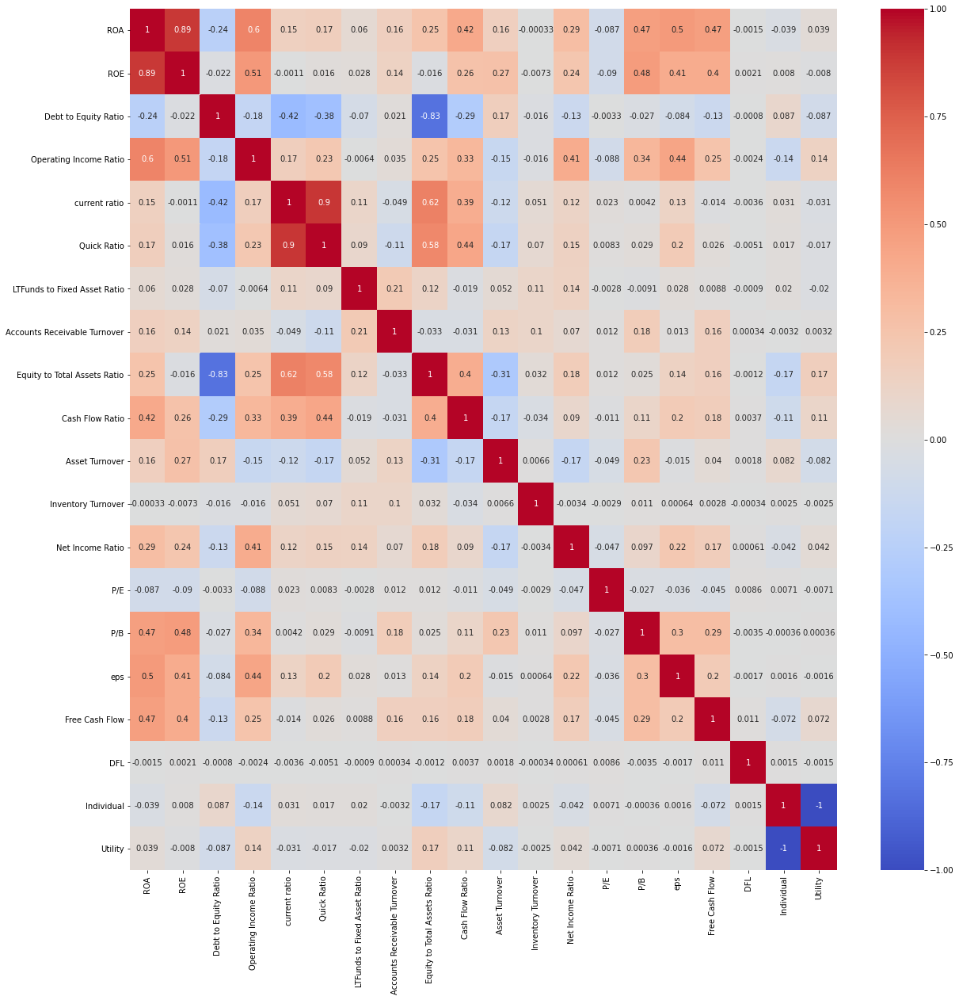

In [26]:
import seaborn as sns
X_train_corr = X_train.corr()
plt.subplots(figsize=(20, 20))
sns.heatmap(X_train_corr,annot=True,cmap='coolwarm')

In [27]:
##相關係數 DataFrame
X_train_corr

,ROA,ROE,Debt to Equity Ratio,Operating Income Ratio,current ratio,Quick Ratio,LTFunds to Fixed Asset Ratio,Accounts Receivable Turnover,Equity to Total Assets Ratio,Cash Flow Ratio,Asset Turnover,Inventory Turnover,Net Income Ratio,P/E,P/B,eps,Free Cash Flow,DFL,Individual,Utility
ROA,1.000000,0.890217,-0.239172,0.595263,0.149695,0.168705,0.060151,0.157013,0.252178,0.416699,0.162991,-0.000333,0.293048,-0.086589,0.472970,0.498916,0.471848,-0.001462,-0.038740,0.038740
ROE,0.890217,1.000000,-0.021696,0.506596,-0.001080,0.016143,0.028493,0.136496,-0.016437,0.263347,0.266272,-0.007319,0.240855,-0.089518,0.484727,0.406190,0.398688,0.002116,0.007977,-0.007977
Debt to Equity Ratio,-0.239172,-0.021696,1.000000,-0.175991,-0.423557,-0.383305,-0.069792,0.021334,-0.827644,-0.285806,0.170078,-0.015932,-0.131211,-0.003255,-0.026686,-0.084185,-0.127487,-0.000803,0.087222,-0.087222
Operating Income Ratio,0.595263,0.506596,-0.175991,1.000000,0.169827,0.225136,-0.006387,0.034941,0.253974,0.332077,-0.153676,-0.016232,0.405957,-0.087561,0.338652,0.444817,0.254400,-0.002389,-0.135373,0.135373
current ratio,0.149695,-0.001080,-0.423557,0.169827,1.000000,0.895859,0.105700,-0.048772,0.615337,0.393100,-0.122961,0.051198,0.123122,0.022554,0.004222,0.125384,-0.013626,-0.003640,0.030632,-0.030632
Quick Ratio,0.168705,0.016143,-0.383305,0.225136,0.895859,1.000000,0.089542,-0.111751,0.579691,0.435409,-0.169299,0.069909,0.148394,0.008261,0.028724,0.196232,0.026331,-0.005137,0.017054,-0.017054
LTFunds to Fixed Asset Ratio,0.060151,0.028493,-0.069792,-0.006387,0.105700,0.089542,1.000000,0.207890,0.118906,-0.018795,0.051659,0.109266,0.139850,-0.002845,-0.009079,0.028053,0.008844,-0.000903,0.019760,-0.019760
Accounts Receivable Turnover,0.157013,0.136496,0.021334,0.034941,-0.048772,-0.111751,0.207890,1.000000,-0.033228,-0.031423,0.130617,0.103538,0.070114,0.012119,0.180177,0.013216,0.157137,0.000336,-0.003202,0.003202
Equity to Total Assets Ratio,0.252178,-0.016437,-0.827644,0.253974,0.615337,0.579691,0.118906,-0.033228,1.000000,0.396867,-0.311763,0.031838,0.180775,0.011981,0.024512,0.135709,0.162171,-0.001172,-0.166720,0.166720
Cash Flow Ratio,0.416699,0.263347,-0.285806,0.332077,0.393100,0.435409,-0.018795,-0.031423,0.396867,1.000000,-0.168534,-0.034429,0.090014,-0.010630,0.108105,0.200470,0.179291,0.003682,-0.106094,0.106094


# 檢驗共線性(刪除r-square較小的)

In [28]:
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
from scipy import stats
lm = LinearRegression()
for name in column_name:
    temp_X_train = X_train[name]
    x_regress = temp_X_train
    y_regress = y_temp  
    regress_x = np.array(x_regress)
    regress_x = regress_x.reshape(5400,1)
    regress_y = np.array(y_regress)
    est = sm.OLS(regress_y,regress_x )
    est2 = est.fit()
    print('')
    print(name)
    print('')
    print(est2.summary())
## p value 是否顯著 如果有 刪除 r squre 小的 


ROA

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.024
Model:                            OLS   Adj. R-squared (uncentered):              0.024
Method:                 Least Squares   F-statistic:                              131.8
Date:                Fri, 18 Feb 2022   Prob (F-statistic):                    3.75e-30
Time:                        11:23:59   Log-Likelihood:                          534.04
No. Observations:                5400   AIC:                                     -1066.
Df Residuals:                    5399   BIC:                                     -1059.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------


Accounts Receivable Turnover

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.017
Model:                            OLS   Adj. R-squared (uncentered):              0.017
Method:                 Least Squares   F-statistic:                              92.97
Date:                Fri, 18 Feb 2022   Prob (F-statistic):                    7.96e-22
Time:                        11:23:59   Log-Likelihood:                          515.03
No. Observations:                5400   AIC:                                     -1028.
Df Residuals:                    5399   BIC:                                     -1021.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
----------

In [29]:
#del X_train['ROA']
#del X_train['Quick Ratio']
#del X_train['Debt to Equity Ratio']

In [30]:
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(X_train)

,ROA,ROE,Debt to Equity Ratio,Operating Income Ratio,current ratio,Quick Ratio,LTFunds to Fixed Asset Ratio,Accounts Receivable Turnover,Equity to Total Assets Ratio,Cash Flow Ratio,Asset Turnover,Inventory Turnover,Net Income Ratio,P/E,P/B,eps,Free Cash Flow,DFL,Individual,Utility
0,0.039833,0.067010,0.682245,0.2249,1.8777,1.5668,3.4070,2.78,0.5944,0.1734,0.26,8.45,0.2400,9.150000,1.44,1.820000,-0.004559,1.047054,1.0,0.0
1,0.013518,0.023370,0.728817,0.1909,1.7509,1.4507,3.4356,2.43,0.5784,0.0954,0.23,8.40,0.1693,7.830000,1.32,0.570000,-0.003146,1.073987,1.0,0.0
2,0.095864,0.170632,0.779949,0.2740,1.7240,1.5748,3.2865,2.87,0.5618,0.4338,0.30,9.55,0.2448,7.060000,1.23,4.320000,0.064420,1.049479,1.0,0.0
3,0.073091,0.133597,0.827815,0.2777,1.6276,1.4553,3.2952,2.77,0.5471,0.2878,0.29,8.85,0.2518,6.600000,1.23,3.150000,0.072272,1.050736,1.0,0.0
4,0.043121,0.084394,0.957130,0.2629,1.4619,1.3292,3.1987,2.92,0.5110,0.2154,0.28,8.78,0.2312,6.790000,1.28,1.940000,0.062256,1.058876,1.0,0.0
5,0.014642,0.025369,0.732622,0.2030,1.5284,1.3421,3.1444,2.42,0.5772,0.1186,0.24,7.79,0.1584,6.590000,1.12,0.550000,0.058346,1.096247,1.0,0.0
6,0.094787,0.167093,0.762828,0.2456,1.7758,1.6246,3.1877,3.12,0.5673,0.4391,0.35,9.87,0.2073,7.150000,1.23,4.430000,0.051313,1.055882,1.0,0.0
7,0.071196,0.128620,0.806565,0.2386,1.6223,1.4415,3.0288,3.02,0.5535,0.2538,0.33,8.70,0.2159,6.860000,1.18,3.240000,0.057303,1.061572,1.0,0.0
8,0.042947,0.080830,0.882105,0.2253,1.5112,1.3603,3.0216,3.08,0.5313,0.1611,0.32,8.78,0.2091,7.640000,1.28,2.190000,0.041345,1.065860,1.0,0.0
9,0.016796,0.029213,0.739304,0.1985,1.5696,1.3854,2.9894,2.73,0.5749,0.0637,0.29,7.72,0.1668,6.700000,1.09,0.770000,0.018037,1.087260,1.0,0.0


In [31]:
##大盤
import datetime
data_tw = pd.DataFrame() ##大盤的每日指數
start = datetime.datetime(2008,5,20) 
end = datetime.datetime(2021,11,24) 
tw = yf.Ticker('^TWII') 
data_i = tw.history(start = start, end = end)    
data_tw = data_tw.append(data_i[['Open','High','Low','Close','Volume']])  
data_tw

,Open,High,Low,Close,Volume
Date,,,,,
2008-05-20,9309.915107,9309.915107,9057.275434,9068.855469,6496800
2008-05-21,9036.537032,9079.876716,8973.117344,9015.537109,5356800
2008-05-22,8898.907629,9007.997070,8878.026846,9007.997070,5864600
2008-05-23,9007.177105,9050.747259,8834.698242,8834.698242,5748800
2008-05-26,8808.707634,8811.037704,8706.748051,8707.797852,4512800
...,...,...,...,...,...
2021-11-17,17705.289062,17764.039062,17669.580078,17764.039062,6399300
2021-11-18,17767.060547,17841.369141,17748.210938,17841.369141,6803100
2021-11-19,17864.189453,17986.179688,17786.050781,17818.310547,6246900


# 標準化

In [32]:
from sklearn import preprocessing
zscore = preprocessing.StandardScaler()
dfl = X_train['DFL']
X_train = zscore.fit_transform(X_train)

X_train = pd.DataFrame(X_train)

X_train.loc[:,14] = dfl

In [33]:
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(X_train)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,-0.170818,-0.256931,-0.461281,1.245646,0.023656,0.292656,-0.092440,-0.664423,0.383523,-0.165079,-1.155802,-0.025612,0.582232,-0.149866,1.047054,-0.151528,-0.615039,-0.004575,0.100504,-0.100504
1,-0.663128,-0.683753,-0.419438,0.951283,-0.092497,0.164171,-0.091044,-0.695945,0.291053,-0.372984,-1.205443,-0.025618,0.304634,-0.164088,1.073987,-0.284624,-0.591565,0.001420,0.100504,-0.100504
2,0.877392,0.756561,-0.373497,1.670741,-0.117138,0.301509,-0.098323,-0.656318,0.195116,0.529006,-1.089614,-0.025498,0.601079,-0.172384,1.049479,0.114663,0.530669,-0.004035,0.100504,-0.100504
3,0.451360,0.394329,-0.330490,1.702775,-0.205443,0.169262,-0.097898,-0.665324,0.110159,0.139849,-1.106161,-0.025571,0.628564,-0.177340,1.050736,-0.009914,0.661090,-0.003756,0.100504,-0.100504
4,-0.109311,-0.086904,-0.214304,1.574640,-0.357229,0.029710,-0.102609,-0.651814,-0.098476,-0.053130,-1.122708,-0.025578,0.547680,-0.175293,1.058876,-0.138751,0.494726,-0.001944,0.100504,-0.100504
5,-0.642099,-0.664202,-0.416018,1.056041,-0.296313,0.043986,-0.105260,-0.696846,0.284118,-0.311146,-1.188896,-0.025681,0.261836,-0.177447,1.096247,-0.286754,0.429790,0.006375,0.100504,-0.100504
6,0.857248,0.721944,-0.388879,1.424861,-0.069688,0.356622,-0.103146,-0.633802,0.226902,0.543133,-1.006878,-0.025465,0.453838,-0.171414,1.055882,0.126376,0.312975,-0.002610,0.100504,-0.100504
7,0.415913,0.345659,-0.349583,1.364257,-0.210298,0.153990,-0.110904,-0.642808,0.147147,0.049224,-1.039972,-0.025587,0.487605,-0.174538,1.061572,-0.000331,0.412471,-0.001344,0.100504,-0.100504
8,-0.112579,-0.121762,-0.281712,1.249109,-0.312069,0.064128,-0.111255,-0.637404,0.018845,-0.197864,-1.056519,-0.025578,0.460906,-0.166135,1.065860,-0.112132,0.147404,-0.000389,0.100504,-0.100504
9,-0.601800,-0.626601,-0.410015,1.017081,-0.258573,0.091905,-0.112827,-0.668926,0.270825,-0.457479,-1.106161,-0.025688,0.294818,-0.176262,1.087260,-0.263329,-0.239728,0.004374,0.100504,-0.100504


In [34]:
X_train1 = np.array(X_train)
print(X_train.shape)

(5400, 20)


# 大盤季RETURN

In [35]:
## 大盤的季報酬 
data_tw['Date'] = data_tw.index
tw_return = []
below_start_tw=[]
for i in range (len(data_fr)) :
    tw_temp_start = str(below_start[i]) ##對應上面個股的日期去對大盤作抓取
    tw_temp_end = str(below_end[i])
    tw_start = data_tw.loc[(data_tw['Date'] == tw_temp_start)]
    tw_start = tw_start.values.tolist()
    tw_s = tw_start[0][0]
    below_start_tw.append(tw_temp_start)
    #print(tw_s)
    tw_end = data_tw.loc[(data_tw['Date'] == tw_temp_end)]
    tw_end = tw_end.values.tolist()
    tw_e = tw_end[0][3]
    #print(tw_e)
    tw_return.append((tw_e - tw_s)/tw_s)
print(len(tw_return))
tw_return

5400


[0.08469785915748838,
 0.01568494669116979,
 -0.019044842306406493,
 0.19257600710175968,
 0.0750253383340841,
 0.17313150417251424,
 -0.07851324411973877,
 0.009712518704044904,
 0.10924387084687112,
 0.00801410480944833,
 0.02126016431321272,
 0.037114252607646635,
 -0.08132431749080145,
 -0.014971040266706466,
 0.03848657546661611,
 0.0007145363453554636,
 0.033778298387796064,
 0.03625756817605855,
 0.015498210535330131,
 0.0825133087153128,
 0.004045866389149954,
 0.11414882308909247,
 -0.0264328009885047,
 -0.01742054539216692,
 0.05850155810066671,
 -0.175218619289387,
 0.014023561880838701,
 0.0717246068107869,
 -0.033941072489402556,
 0.03605667578047659,
 0.04028292741318964,
 0.039598715161454114,
 0.04607538556370142,
 -0.055558025428030115,
 0.04434931597745767,
 0.10889657755492048,
 -0.04718091064714262,
 0.03726649087817064,
 -0.09645240807835959,
 0.1100377381991356,
 -0.041649337115948426,
 -0.179042146783868,
 0.0029004715355762825,
 0.059436912662282945,
 0.04939375

In [36]:
##個股 - 大盤  (2021 Q2 - 2008 Q2)
y_train = []
for i in range(5400):
    y_train.append(y_temp[i] - tw_return[i]) 
y_train = pd.DataFrame(y_train)
y_train   

,0
0,-0.032410
1,-0.045881
2,0.230076
3,-0.219477
4,-0.109896
...,...
5395,-0.067326
5396,0.138862
5397,0.101588
5398,0.030401


# Run Model

In [37]:
import tensorflow as tf
from tensorflow import keras
from keras import backend as K
from keras.models import Sequential
from keras.layers import Dense
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing
from keras.layers.core import Dense, Dropout, Activation

In [38]:
#找出 test data的 index (2018Q3 - 2020Q2 設為test data)
index_test=[] 
for i in range (5400):
    if i%54==0:
        for j in range (0,12,1):
            index_test.append(i+j)
print(len(index_test))

1200


In [39]:
## 2018 Q3以前為 train data
index_train=[]
for i in range (5400):
    if i not in index_test:
            index_train.append(i)
print(len(index_train))

4200


# 2021Q1-2018Q2 大盤報酬率

In [40]:
index_TW=[]
for i in range (12):
    index_TW.append(i)
print(len(index_TW))

12


In [41]:
TW_return = []
for i in index_TW :
    TW_return.append(tw_return[i])
print(TW_return)

[0.08469785915748838, 0.01568494669116979, -0.019044842306406493, 0.19257600710175968, 0.0750253383340841, 0.17313150417251424, -0.07851324411973877, 0.009712518704044904, 0.10924387084687112, 0.00801410480944833, 0.02126016431321272, 0.037114252607646635]


# X_test & X_train 

In [42]:
## X test data 
X_test = np.delete(X_train1, index_train,0)
print(X_test.ndim) # y軸-時間 x軸-feature
print(X_test.shape)
print(X_test.size) 
print(type(X_test)) 

2
(1200, 20)
24000
<class 'numpy.ndarray'>


In [43]:
## X train data
X_train = np.delete(X_train1, index_test,0)
print(X_train.ndim)
print(X_train.shape)
print(X_train.size)
print(type(X_train))

2
(4200, 20)
84000
<class 'numpy.ndarray'>


# Y_train & Y_test

In [44]:
# Y train data
y_train = np.array(y_train)
Y_train=np.delete(y_train, index_test,0)
print(Y_train.ndim)
print(Y_train.shape)
print(Y_train.size)
print(type(Y_train))

2
(4200, 1)
4200
<class 'numpy.ndarray'>


In [45]:
## Y test data
Y_test=np.delete(y_train, index_train,0)
print(Y_test.ndim)
print(Y_test.shape)
print(Y_test.size)
print(type(Y_test))

2
(1200, 1)
1200
<class 'numpy.ndarray'>


# Run Model

In [46]:
best_Quarterly_return = [[-1],[-1],[-1],[-1],[-1],[-1],[-1],[-1],[-1],[-1]]
best_total_return = -1
BUY_LIST = []
frist_layer = [40, 80, 120, 160, 200]
second_layer = [0.5, 0.75, 1, 1.25, 1.5]
third_layer = [0.5, 0.75, 1, 1.25, 1.5]
Batch_size = [16, 32, 64]
ACTIVATION = ['elu','relu','sigmoid']
callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10)
#EARLY STOPPING 提前終止訓練 PATIENCE容忍在多少個 epoch 內監控的數據都沒有出現改善
Table_1 = []
Table_2 = []

MSE_list=[]

In [47]:
for a in range(100): 
                
    model = Sequential()                                                                      

    model.add(Dense(80, input_dim=20 , kernel_initializer='normal', activation='sigmoid')) 
    model.add(Dense(80, activation='sigmoid'))                                            
    model.add(Dense(80, activation='sigmoid'))                                             
    model.add(Dense(1, activation='linear'))                                        
    model.compile(loss='mse',optimizer=tf.keras.optimizers.Adam(0.0005))                          
                                                                                                   
    model.summary() 
    history = model.fit(
        X_train, 
        Y_train,
        epochs=100, 
        batch_size=16,  
        verbose=1, 
        validation_split=0.15,
        callbacks=[callback],

        )
                   

    hist = pd.DataFrame(history.history)
    hist.tail()
    
    y_predict = model.predict(X_test)
    company_buy = []                   
    buy_table = []
    
    MSE = 0
    for i in range(1200):
        MSE+=((Y_test[i])-y_predict[i])*(Y_test[i]-y_predict[i])
    MSE/=1200
    MSE_list.append(MSE)
    print("MSE:",MSE)
    
    for i in range(12):
        SORT=[] 
        check=[] 
        for j in range (100):
            SORT.append(y_predict[i+12*j])
            check.append(0)     
        SORT.sort()
        buy_table_list=[]
        for j in range(100):
            for k in range(100):
                if check[k]==0 and y_predict[i+12*k]==SORT[-(j+1)]:
                    buy_table_list.append(k)
                    check[k]=1
                    break
        buy_table.append(buy_table_list)
        hold=SORT[-30]
        number=0
        buy=[]
        for j in range(100):
            if y_predict[i+12*j]>hold:
                buy.append(j)
                number+=1
            if y_predict[i+12*j]==hold:
                buy.append(j)
                number+=1
                if number==30:
                    break
        company_buy.append(buy)
    Quarter_return=[]
    for i in range(12):
        quarterly_return=0
        for j in range(30):
            quarterly_return+=Y_test[(company_buy[i][j])*12+i]
        quarterly_return /= 30 
        Quarter_return.append(quarterly_return)
        
    stock_all_Quarterly_return=1 #相對複利季報酬率
    stock_all_Quarterly_return_absolute=1 #絕對複利季報酬率
    
    for i in range(12):
        stock_all_Quarterly_return*=(1+Quarter_return[i])  ##要減1
        stock_all_Quarterly_return_absolute*=(1+Quarter_return[i]+TW_return[i]) ##要減1
                    
    print("Quarter_return:",Quarter_return)
    print("投資組合績效的相對累積複利報酬率:",stock_all_Quarterly_return)
    print("投資組合績效的絕對累積複利報酬率:",stock_all_Quarterly_return_absolute)
 
    if best_total_return < stock_all_Quarterly_return_absolute:
        best_total_return = stock_all_Quarterly_return_absolute
        BUY_LIST = company_buy
        Table_1 = buy_table

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 80)                1680      
_________________________________________________________________
dense_1 (Dense)              (None, 80)                6480      
_________________________________________________________________
dense_2 (Dense)              (None, 80)                6480      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 81        
Total params: 14,721
Trainable params: 14,721
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
224/224 [==============================] - 4s 11ms/step - loss: 0.1128 - val_loss: 0.0314
Epoch 2/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.0321
Epoch 3/100
224/224 [==========================

224/224 [==============================] - 0s 1ms/step - loss: 0.0250 - val_loss: 0.0317
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0262 - val_loss: 0.0318
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0339
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0276 - val_loss: 0.0347
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0297 - val_loss: 0.0401
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0344 - val_loss: 0.0314
Epoch 22/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0285 - val_loss: 0.0323
Epoch 23/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0328 - val_loss: 0.0323
Epoch 24/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0313
Epoch 25/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0330 - val_loss: 

224/224 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0313
Epoch 20/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.0329
Epoch 21/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.0317
Epoch 22/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.0314
Epoch 23/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.0323
Epoch 24/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0322
Epoch 25/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.0313
Epoch 26/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0320 - val_loss: 0.0320
Epoch 27/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0272 - val_loss: 0.0331
Epoch 28/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 0.0317
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0317
Epoch 22/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.0353
Epoch 23/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0314
MSE: [0.0412167]
Quarter_return: [array([0.00678066]), array([-0.00295084]), array([0.18602856]), array([0.06488592]), array([-0.03075605]), array([0.05112946]), array([0.07624138]), array([0.02648888]), array([-0.03698164]), array([0.06719856]), array([-0.01911919]), array([0.04949941])]
投資組合績效的相對累積複利報酬率: [1.50966695]
投資組合績效的絕對累積複利報酬率: [2.6916125]
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_24 (Dense)             (None, 80)                1680      
__________________________________

224/224 [==============================] - 0s 1ms/step - loss: 0.0320 - val_loss: 0.0313
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0351 - val_loss: 0.0314
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0319 - val_loss: 0.0323
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0328
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0306 - val_loss: 0.0315
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0291 - val_loss: 0.0316
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0335
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0308 - val_loss: 0.0314
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0278 - val_loss: 0.0322
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0317 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0281 - val_loss: 0.0329
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0365
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0289 - val_loss: 0.0315
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0319 - val_loss: 0.0326
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0358 - val_loss: 0.0313
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0337 - val_loss: 0.0316
Epoch 21/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.0314
MSE: [0.04121915]
Quarter_return: [array([0.01604447]), array([-0.00760252]), array([0.17725341]), array([0.0325832]), array([-0.03017808]), array([0.06840098]), array([0.06835412]), array([0.01958489]), array([-0.03394185]), array([0.05410348]), array([-0.02009544]), array([0.0584747])]
投資組合績效的相對累

224/224 [==============================] - 0s 1ms/step - loss: 0.0326 - val_loss: 0.0313
Epoch 37/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0313
Epoch 38/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0359 - val_loss: 0.0315
Epoch 39/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0313
Epoch 40/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0274 - val_loss: 0.0313
Epoch 41/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.0313
Epoch 42/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.0321
Epoch 43/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.0317
Epoch 44/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0355 - val_loss: 0.0348
Epoch 45/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 

Quarter_return: [array([0.02228965]), array([0.00576754]), array([0.15590124]), array([0.05572695]), array([-0.02229039]), array([0.04799011]), array([0.07055653]), array([0.02864819]), array([-0.03550887]), array([0.07372349]), array([-0.04567728]), array([0.03428276])]
投資組合績效的相對累積複利報酬率: [1.44714718]
投資組合績效的絕對累積複利報酬率: [2.57974614]
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_52 (Dense)             (None, 80)                1680      
_________________________________________________________________
dense_53 (Dense)             (None, 80)                6480      
_________________________________________________________________
dense_54 (Dense)             (None, 80)                6480      
_________________________________________________________________
dense_55 (Dense)             (None, 1)                 81        
Total params: 14,721
Trainable params: 14,721
Non

224/224 [==============================] - 0s 1ms/step - loss: 0.0312 - val_loss: 0.0334
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0300 - val_loss: 0.0317
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0376 - val_loss: 0.0315
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0321
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0392 - val_loss: 0.0321
MSE: [0.04178292]
Quarter_return: [array([0.02455364]), array([-0.00375342]), array([0.15200784]), array([0.06300247]), array([-0.0217593]), array([0.06250428]), array([0.07534663]), array([0.02552558]), array([-0.02632395]), array([0.05055825]), array([-0.02818593]), array([0.04637706])]
投資組合績效的相對累積複利報酬率: [1.49028272]
投資組合績效的絕對累積複利報酬率: [2.64518566]
Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #

224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 0.0315
Epoch 32/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0293 - val_loss: 0.0322
Epoch 33/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0297 - val_loss: 0.0315
Epoch 34/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0337 - val_loss: 0.0316
Epoch 35/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0290 - val_loss: 0.0317
Epoch 36/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0328 - val_loss: 0.0314
Epoch 37/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0332 - val_loss: 0.0316
Epoch 38/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0329 - val_loss: 0.0323
Epoch 39/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0329 - val_loss: 0.0322
Epoch 40/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0318 - val_loss: 0.0314
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0325
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0325
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0324
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0315 - val_loss: 0.0341
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0374
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0336 - val_loss: 0.0319
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0295 - val_loss: 0.0319
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0288 - val_loss: 0.0342
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0339

224/224 [==============================] - 1s 2ms/step - loss: 0.0421 - val_loss: 0.0315
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 0.0318
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0317 - val_loss: 0.0327
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0351 - val_loss: 0.0317
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0269 - val_loss: 0.0317
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0386 - val_loss: 0.0318
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0352 - val_loss: 0.0316
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0329
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0291 - val_loss: 0.0315
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0317
E

224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0265 - val_loss: 0.0316
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0329 - val_loss: 0.0330
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0361 - val_loss: 0.0313
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0332 - val_loss: 0.0314
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0314
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0306 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0308 - val_loss: 0.0315
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0312 - val_loss: 0.0314
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0288 - val_loss: 0.0359


224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0314
Epoch 40/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0289 - val_loss: 0.0318
Epoch 41/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0264 - val_loss: 0.0340
Epoch 42/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0313
Epoch 43/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0301 - val_loss: 0.0320
Epoch 44/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 0.0328
Epoch 45/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0313 - val_loss: 0.0321
Epoch 46/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0320
Epoch 47/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0318
Epoch 48/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0249 - val_loss: 

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_112 (Dense)            (None, 80)                1680      
_________________________________________________________________
dense_113 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_114 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_115 (Dense)            (None, 1)                 81        
Total params: 14,721
Trainable params: 14,721
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.0607 - val_loss: 0.0316
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0290 - val_loss: 0.0346
Epoch 3/100
224/224 [========================

224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0336
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0278 - val_loss: 0.0322
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0322
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0382 - val_loss: 0.0314
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0300 - val_loss: 0.0318
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0314
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0336 - val_loss: 0.0314
Epoch 22/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0361 - val_loss: 0.0313
Epoch 23/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0319
Epoch 24/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0322 - val_loss: 

224/224 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0319
Epoch 4/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.0314
Epoch 5/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0339
Epoch 6/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.0345
Epoch 8/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0317
Epoch 9/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.0323
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 0.0316
Epoch 11/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.0314
Epoch 12/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0338

Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.0483 - val_loss: 0.0314
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0306 - val_loss: 0.0316
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0334 - val_loss: 0.0317
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0316 - val_loss: 0.0314
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0321
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0335 - val_loss: 0.0339
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0334 - val_loss: 0.0316
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0291 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0281 - val_loss: 0.0318
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0301 - val_lo

224/224 [==============================] - 0s 1ms/step - loss: 0.0293 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0336
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0346 - val_loss: 0.0325
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0339 - val_loss: 0.0314
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0442 - val_loss: 0.0315
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0316
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0327
Epoch 15/100
224/224 [==============================] - ETA: 0s - loss: 0.035 - 0s 1ms/step - loss: 0.0353 - val_loss: 0.0314
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0320
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - lo

Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_156 (Dense)            (None, 80)                1680      
_________________________________________________________________
dense_157 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_158 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_159 (Dense)            (None, 1)                 81        
Total params: 14,721
Trainable params: 14,721
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.0486 - val_loss: 0.0319
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 0.0314
Epoch 3/100
224/224 [========================

224/224 [==============================] - 1s 2ms/step - loss: 0.0344 - val_loss: 0.0321
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0365 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0263 - val_loss: 0.0313
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0272 - val_loss: 0.0320
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0265 - val_loss: 0.0315
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0263 - val_loss: 0.0334
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0322 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0356 - val_loss: 0.0319
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0320
E

224/224 [==============================] - 0s 1ms/step - loss: 0.0282 - val_loss: 0.0316
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0381 - val_loss: 0.0314
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0328 - val_loss: 0.0315
MSE: [0.04127666]
Quarter_return: [array([0.02998107]), array([-0.00195582]), array([0.20592984]), array([0.06224388]), array([-0.02089287]), array([0.06059819]), array([0.07376276]), array([0.03236743]), array([-0.03806129]), array([0.04560678]), array([0.00384677]), array([0.04580167])]
投資組合績效的相對累積複利報酬率: [1.60059543]
投資組合績效的絕對累積複利報酬率: [2.84394873]
Model: "sequential_44"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_176 (Dense)            (None, 80)                1680      
_________________________________________________________________
dense_177 (Dense)            (None, 80)                6480      
__

224/224 [==============================] - 0s 1ms/step - loss: 0.0313 - val_loss: 0.0316
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0287 - val_loss: 0.0317
Epoch 11/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0326
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0301 - val_loss: 0.0315
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0283 - val_loss: 0.0336
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0274 - val_loss: 0.0313
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0314 - val_loss: 0.0313
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0314
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0323 - val_loss: 0.0329
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0288 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0274 - val_loss: 0.0313
Epoch 37/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0313
Epoch 38/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0365 - val_loss: 0.0327
MSE: [0.04245166]
Quarter_return: [array([0.01876109]), array([0.00576754]), array([0.14648741]), array([0.06264564]), array([-0.02798029]), array([0.05546606]), array([0.07461186]), array([0.02593064]), array([-0.02658229]), array([0.07534183]), array([-0.04193482]), array([0.03601968])]
投資組合績效的相對累積複利報酬率: [1.46698456]
投資組合績效的絕對累積複利報酬率: [2.60928496]
Model: "sequential_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_192 (Dense)            (None, 80)                1680      
_________________________________________________________________
dense_193 (Dense)            (None, 80)                6480      
__

224/224 [==============================] - 0s 1ms/step - loss: 0.0314 - val_loss: 0.0325
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0276 - val_loss: 0.0313
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0319
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0322
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0364 - val_loss: 0.0315
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0295 - val_loss: 0.0328
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0306 - val_loss: 0.0316
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0319
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0287 - val_loss: 0.0314
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0284 - val_loss: 

Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.2019 - val_loss: 0.0330
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0273 - val_loss: 0.0336
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0316
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0295 - val_loss: 0.0317
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0321 - val_loss: 0.0328
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0274 - val_loss: 0.0328
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0326 - val_loss: 0.0313
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0313
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0316 - val_lo

Model: "sequential_54"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_216 (Dense)            (None, 80)                1680      
_________________________________________________________________
dense_217 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_218 (Dense)            (None, 80)                6480      
_________________________________________________________________
dense_219 (Dense)            (None, 1)                 81        
Total params: 14,721
Trainable params: 14,721
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.0379 - val_loss: 0.0330
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0346 - val_loss: 0.0314
Epoch 3/100
224/224 [========================

224/224 [==============================] - 0s 1ms/step - loss: 0.0413 - val_loss: 0.0318
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0305 - val_loss: 0.0313
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0281 - val_loss: 0.0316
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0325 - val_loss: 0.0314
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0270 - val_loss: 0.0313
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0255 - val_loss: 0.0316
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0368 - val_loss: 0.0313
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0314
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0296 - val_loss: 0.0316
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0319 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0296 - val_loss: 0.0316
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0270 - val_loss: 0.0315
Epoch 22/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0315 - val_loss: 0.0313
Epoch 23/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0258 - val_loss: 0.0320
Epoch 24/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0274 - val_loss: 0.0330
Epoch 25/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0313
Epoch 26/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0348 - val_loss: 0.0313
Epoch 27/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.0315
Epoch 28/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0299 - val_loss: 0.0314
MSE: [0.04117688]
Quarter_return: [array([0.00746337]), array([0.00037899]), array([0.14657041]

224/224 [==============================] - 0s 1ms/step - loss: 0.0284 - val_loss: 0.0313
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0315
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0317 - val_loss: 0.0329
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0314
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0338 - val_loss: 0.0326
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0240 - val_loss: 0.0318
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0324 - val_loss: 0.0331
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0313 - val_loss: 0.0320
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0343 - val_loss: 0.0313
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0314 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0299 - val_loss: 0.0317
Epoch 25/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0314
Epoch 26/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0343 - val_loss: 0.0325
Epoch 27/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0268 - val_loss: 0.0317
Epoch 28/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0289 - val_loss: 0.0320
Epoch 29/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0351 - val_loss: 0.0318
MSE: [0.04169286]
Quarter_return: [array([0.01090154]), array([0.00576754]), array([0.14895258]), array([0.06422532]), array([-0.02409575]), array([0.05533433]), array([0.08422622]), array([0.02521238]), array([-0.02805847]), array([0.07537867]), array([-0.03291936]), array([0.03805449])]
投資組合績效的相對累積複利報酬率: [1.49333617]
投資組合績效的絕對累積複利報酬率: [2.65808351]
Model: "sequential_62"
__________________________

224/224 [==============================] - 1s 2ms/step - loss: 0.0977 - val_loss: 0.0314
Epoch 2/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.0325
Epoch 3/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0326
Epoch 4/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.0316
Epoch 5/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0313
Epoch 6/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0360
Epoch 7/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.0324
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0318 - val_loss: 0.0338
Epoch 9/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.0316
Epoch 10/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0313
E

224/224 [==============================] - 1s 2ms/step - loss: 0.0543 - val_loss: 0.0314
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0279 - val_loss: 0.0356
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0289 - val_loss: 0.0316
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0253 - val_loss: 0.0314
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0339 - val_loss: 0.0315
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0299 - val_loss: 0.0394
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0354 - val_loss: 0.0323
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0290 - val_loss: 0.0315
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0308 - val_loss: 0.0318
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0314
E

Epoch 1/100
224/224 [==============================] - 1s 2ms/step - loss: 0.1454 - val_loss: 0.0313
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0316
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0279 - val_loss: 0.0319
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0372
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0290 - val_loss: 0.0346
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0289 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0322 - val_loss: 0.0318
Epoch 8/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.0327
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0378 - val_loss: 0.0365
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0293 - val_lo

224/224 [==============================] - 0s 1ms/step - loss: 0.0336 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0322
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0323 - val_loss: 0.0313
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0327
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0341 - val_loss: 0.0315
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0321
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0284 - val_loss: 0.0318
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0281 - val_loss: 0.0314
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0340 - val_loss: 0.0333


224/224 [==============================] - 0s 1ms/step - loss: 0.0351 - val_loss: 0.0332
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0328 - val_loss: 0.0314
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0291 - val_loss: 0.0318
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0283 - val_loss: 0.0316
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0358 - val_loss: 0.0341
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0362 - val_loss: 0.0320
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0333 - val_loss: 0.0314
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0313
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 0.0324
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0321 - val_loss: 0.03

224/224 [==============================] - 0s 1ms/step - loss: 0.0282 - val_loss: 0.0338
Epoch 19/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.0320
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0322 - val_loss: 0.0314
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0316 - val_loss: 0.0317
Epoch 22/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0316
Epoch 23/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0315
Epoch 24/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.0315
Epoch 25/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0287 - val_loss: 0.0331
Epoch 26/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0331
Epoch 27/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0315 - val_loss: 0.0317
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 0.0317
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0315 - val_loss: 0.0351
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0310 - val_loss: 0.0315
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0315
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0357 - val_loss: 0.0313
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0341 - val_loss: 0.0327
Epoch 12/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0296 - val_loss: 0.0324
Epoch 13/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0374 - val_loss: 0.035

224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0326
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0266 - val_loss: 0.0314
Epoch 4/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.0316
Epoch 5/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.0316
Epoch 6/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.0313
Epoch 7/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0320
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0279 - val_loss: 0.0314
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0314 - val_loss: 0.0313
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0313
Epoch 11/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0366 - val_loss: 0.0320


224/224 [==============================] - 1s 2ms/step - loss: 0.2214 - val_loss: 0.0313
Epoch 2/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0296 - val_loss: 0.0326
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0331 - val_loss: 0.0313
Epoch 5/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0346
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0324
Epoch 7/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.0331
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0313
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0280 - val_loss: 0.0333
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0334
E

224/224 [==============================] - 1s 2ms/step - loss: 0.0377 - val_loss: 0.0312
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0275 - val_loss: 0.0317
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0318 - val_loss: 0.0321
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0360 - val_loss: 0.0314
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0324 - val_loss: 0.0322
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0321
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0314
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0316 - val_loss: 0.0358
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0331 - val_loss: 0.0315
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0393 - val_loss: 0.0320
E

224/224 [==============================] - 1s 2ms/step - loss: 0.0699 - val_loss: 0.0334
Epoch 2/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.0352
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0265 - val_loss: 0.0314
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0324
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0260 - val_loss: 0.0316
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0338 - val_loss: 0.0338
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0317
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0283 - val_loss: 0.0324
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0307 - val_loss: 0.0343
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0297 - val_loss: 0.0314
E

224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0318
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0314 - val_loss: 0.0315
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0309 - val_loss: 0.0322
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0284 - val_loss: 0.0343
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0312 - val_loss: 0.0348
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0332 - val_loss: 0.0314
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0279 - val_loss: 0.0315
Epoch 22/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0318
Epoch 23/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0273 - val_loss: 0.0348
Epoch 24/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0303 - val_loss: 

224/224 [==============================] - 1s 2ms/step - loss: 0.1177 - val_loss: 0.0313
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0410 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0297 - val_loss: 0.0338
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0278 - val_loss: 0.0315
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0283 - val_loss: 0.0314
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0294 - val_loss: 0.0323
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0276 - val_loss: 0.0316
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0300 - val_loss: 0.0313
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0320 - val_loss: 0.0340
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0277 - val_loss: 0.0330
E

224/224 [==============================] - 0s 1ms/step - loss: 0.0292 - val_loss: 0.0319
Epoch 58/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0346 - val_loss: 0.0331
Epoch 59/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0321 - val_loss: 0.0312
Epoch 60/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0313 - val_loss: 0.0314
Epoch 61/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0267 - val_loss: 0.0314
Epoch 62/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0273 - val_loss: 0.0313
Epoch 63/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0286 - val_loss: 0.0313
Epoch 64/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0320 - val_loss: 0.0313
Epoch 65/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0259 - val_loss: 0.0314
Epoch 66/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0256 - val_loss: 

224/224 [==============================] - 0s 1ms/step - loss: 0.0331 - val_loss: 0.0314
Epoch 14/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0312 - val_loss: 0.0328
Epoch 15/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0304 - val_loss: 0.0315
Epoch 16/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0282 - val_loss: 0.0315
Epoch 17/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0298 - val_loss: 0.0317
Epoch 18/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0284 - val_loss: 0.0313
Epoch 19/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0308 - val_loss: 0.0345
Epoch 20/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0266 - val_loss: 0.0313
Epoch 21/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0271 - val_loss: 0.0314
Epoch 22/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0259 - val_loss: 

224/224 [==============================] - 1s 2ms/step - loss: 0.0380 - val_loss: 0.0323
Epoch 2/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0404 - val_loss: 0.0313
Epoch 3/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0332 - val_loss: 0.0314
Epoch 4/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0397 - val_loss: 0.0360
Epoch 5/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0328 - val_loss: 0.0329
Epoch 6/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0316 - val_loss: 0.0315
Epoch 7/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0302 - val_loss: 0.0314
Epoch 8/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0311 - val_loss: 0.0318
Epoch 9/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0296 - val_loss: 0.0431
Epoch 10/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0279 - val_loss: 0.0313
E

224/224 [==============================] - 0s 1ms/step - loss: 0.0282 - val_loss: 0.0314
Epoch 42/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0313
Epoch 43/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.0315
Epoch 44/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0315 - val_loss: 0.0315
Epoch 45/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.0336
Epoch 46/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0324
Epoch 47/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0315
Epoch 48/100
224/224 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0316
Epoch 49/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0306 - val_loss: 0.0324
Epoch 50/100
224/224 [==============================] - 0s 1ms/step - loss: 0.0318 - val_loss: 

In [48]:
MSE_list.sort()
print(MSE_list)

[array([0.04110521]), array([0.04110848]), array([0.04112188]), array([0.0411313]), array([0.04113195]), array([0.04114042]), array([0.04114089]), array([0.04114468]), array([0.04114494]), array([0.04115298]), array([0.04115527]), array([0.04115891]), array([0.04115918]), array([0.04116706]), array([0.0411726]), array([0.04117634]), array([0.04117688]), array([0.04118083]), array([0.04120917]), array([0.04121201]), array([0.04121443]), array([0.0412167]), array([0.04121915]), array([0.04121952]), array([0.0412295]), array([0.04122967]), array([0.04123154]), array([0.04125892]), array([0.04126357]), array([0.04126984]), array([0.04127243]), array([0.04127666]), array([0.04128225]), array([0.04128555]), array([0.0412859]), array([0.04129025]), array([0.04131353]), array([0.0413248]), array([0.04135007]), array([0.04136817]), array([0.04139886]), array([0.04141333]), array([0.04142113]), array([0.04142948]), array([0.04143291]), array([0.04144148]), array([0.0414848]), array([0.04155792])

# 輸出投組結果並轉呈DATAFRAME

In [49]:
result_table = pd.DataFrame()
for j in range(12):
    company_order = []
    company_return = []
    for i in range(100):
        company_order.append(company_100[Table_1[11-j][i]])
        stock_return = Y_test[(Table_1[11-j][i])*12+(11-j)]
        company_return.append(stock_return[0])
    column_name = 'Q'+ str(j+1)
    retrun_name = column_name + ' return'
    result_table[column_name] = company_order
    result_table[retrun_name] = company_return 
                        

In [50]:
print("等權重絕對報酬率:",best_total_return)
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(result_table)

等權重絕對報酬率: [2.86193504]


,Q1,Q1 return,Q2,Q2 return,Q3,Q3 return,Q4,Q4 return,Q5,Q5 return,Q6,Q6 return,Q7,Q7 return,Q8,Q8 return,Q9,Q9 return,Q10,Q10 return,Q11,Q11 return,Q12,Q12 return
0,2354 鴻海科技,-0.054856,2376 技嘉,-0.027919,6505 台塑化,-0.107209,6505 台塑化,-0.124581,2345 智邦,0.042311,2354 鴻海科技,-0.029506,2227 裕隆日産汽車,-0.134514,1301 台塑,0.026225,3034 聯詠,0.579236,2354 鴻海科技,-0.093812,2354 鴻海科技,0.048370,2354 鴻海科技,-0.058544
1,3034 聯詠,0.336902,2377 微星,-0.086086,2354 鴻海科技,0.068294,2108 南帝,-0.172236,3034 聯詠,-0.041531,3034 聯詠,0.009955,2354 鴻海科技,-0.147262,6505 台塑化,0.053426,2354 鴻海科技,0.152385,3034 聯詠,-0.054925,2377 微星,-0.289214,2376 技嘉,0.610014
2,2377 微星,0.245934,2345 智邦,0.134837,2377 微星,0.128173,2377 微星,-0.079885,2108 南帝,0.007066,2376 技嘉,0.178689,3034 聯詠,0.241852,6116 彩晶,0.069553,2345 智邦,-0.061159,2345 智邦,0.076290,3034 聯詠,0.008507,2377 微星,0.329871
3,6505 台塑化,-0.037114,2354 鴻海科技,-0.022897,3034 聯詠,-0.022977,3006 晶豪科,-0.107679,6505 台塑化,-0.076310,2377 微星,0.171297,6505 台塑化,-0.242328,2354 鴻海科技,-0.115994,3006 晶豪科,0.535221,2376 技嘉,0.337598,3533 嘉澤,-0.044587,3034 聯詠,-0.072119
4,2376 技嘉,0.123508,6505 台塑化,-0.029918,2376 技嘉,0.206835,3034 聯詠,0.142185,2376 技嘉,0.121660,2345 智邦,0.233827,3533 嘉澤,-0.163926,3034 聯詠,0.039207,2458 義隆,0.100200,2377 微星,0.203073,2108 南帝,-0.143685,1476 儒鴻,0.142046
5,2345 智邦,-0.022114,3034 聯詠,-0.004311,2108 南帝,-0.043606,3533 嘉澤,0.054142,2377 微星,0.101657,2108 南帝,0.252855,2458 義隆,0.391116,2108 南帝,0.506127,2108 南帝,-0.223878,6176 瑞儀,-0.014150,1476 儒鴻,-0.192758,3533 嘉澤,0.321467
6,2108 南帝,0.047223,3006 晶豪科,-0.133200,3533 嘉澤,0.182883,2376 技嘉,-0.122836,3006 晶豪科,0.105912,6505 台塑化,0.099578,2377 微星,0.174091,2376 技嘉,-0.229388,8046 南電,0.931966,3545 敦泰,0.684161,2376 技嘉,-0.187616,3006 晶豪科,0.095753
7,6116 彩晶,-0.086341,2108 南帝,0.044881,1434 福懋,-0.019862,2354 鴻海科技,-0.030592,3533 嘉澤,0.025463,3006 晶豪科,0.269321,1476 儒鴻,0.255878,8046 南電,-0.113758,2377 微星,-0.046235,3006 晶豪科,0.428819,2015 豐興,-0.013011,6505 台塑化,-0.001364
8,1605 華新,-0.019773,6116 彩晶,-0.015360,1476 儒鴻,-0.071369,3532 台勝科,-0.052372,2395 研華,-0.037970,2015 豐興,0.043393,2108 南帝,-0.056515,2015 豐興,-0.075025,3533 嘉澤,0.095480,3533 嘉澤,-0.042327,2458 義隆,-0.227708,1434 福懋,-0.109615
9,3006 晶豪科,0.038570,6269 台郡,-0.144337,3006 晶豪科,0.114342,2015 豐興,-0.181810,6116 彩晶,0.096278,3533 嘉澤,0.370180,2376 技嘉,0.277460,3533 嘉澤,-0.010509,2376 技嘉,-0.075625,2458 義隆,0.191057,1434 福懋,0.005979,1504 東元,-0.003663


In [51]:
buy_result_table = pd.DataFrame()
for j in range(12):
    company_order = []
    company_return = []
    for i in range(25):
        company_order.append(company_100[Table_1[11-j][i]])
    column_name = 'Q'+ str(j+1)
    buy_result_table[column_name] = company_order

In [52]:
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(buy_result_table)

,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Q12
0,2354 鴻海科技,2376 技嘉,6505 台塑化,6505 台塑化,2345 智邦,2354 鴻海科技,2227 裕隆日産汽車,1301 台塑,3034 聯詠,2354 鴻海科技,2354 鴻海科技,2354 鴻海科技
1,3034 聯詠,2377 微星,2354 鴻海科技,2108 南帝,3034 聯詠,3034 聯詠,2354 鴻海科技,6505 台塑化,2354 鴻海科技,3034 聯詠,2377 微星,2376 技嘉
2,2377 微星,2345 智邦,2377 微星,2377 微星,2108 南帝,2376 技嘉,3034 聯詠,6116 彩晶,2345 智邦,2345 智邦,3034 聯詠,2377 微星
3,6505 台塑化,2354 鴻海科技,3034 聯詠,3006 晶豪科,6505 台塑化,2377 微星,6505 台塑化,2354 鴻海科技,3006 晶豪科,2376 技嘉,3533 嘉澤,3034 聯詠
4,2376 技嘉,6505 台塑化,2376 技嘉,3034 聯詠,2376 技嘉,2345 智邦,3533 嘉澤,3034 聯詠,2458 義隆,2377 微星,2108 南帝,1476 儒鴻
5,2345 智邦,3034 聯詠,2108 南帝,3533 嘉澤,2377 微星,2108 南帝,2458 義隆,2108 南帝,2108 南帝,6176 瑞儀,1476 儒鴻,3533 嘉澤
6,2108 南帝,3006 晶豪科,3533 嘉澤,2376 技嘉,3006 晶豪科,6505 台塑化,2377 微星,2376 技嘉,8046 南電,3545 敦泰,2376 技嘉,3006 晶豪科
7,6116 彩晶,2108 南帝,1434 福懋,2354 鴻海科技,3533 嘉澤,3006 晶豪科,1476 儒鴻,8046 南電,2377 微星,3006 晶豪科,2015 豐興,6505 台塑化
8,1605 華新,6116 彩晶,1476 儒鴻,3532 台勝科,2395 研華,2015 豐興,2108 南帝,2015 豐興,3533 嘉澤,3533 嘉澤,2458 義隆,1434 福懋
9,3006 晶豪科,6269 台郡,3006 晶豪科,2015 豐興,6116 彩晶,3533 嘉澤,2376 技嘉,3533 嘉澤,2376 技嘉,2458 義隆,1434 福懋,1504 東元


In [53]:
buy_result_table.to_excel('buy_table.xlsx')

# 個股被選到次數

In [54]:
Table_2 = []
for i in range(100):
    Table_2.append(0)
for i in range(12):
    for j in range(len(BUY_LIST[i])):
        Table_2[BUY_LIST[i][j]] += 1 ## 被選到的公司次數即加1

In [55]:
Select_times_Table = pd.DataFrame()
Select_times_Table ['Company'] = company_100
Select_times_Table ['Select times'] = Table_2
Select_times_Table

,Company,Select times
0,1101 台泥,0
1,1102 亞泥,0
2,1216 統一企業,0
3,1229 聯華,5
4,1301 台塑,1
...,...,...
95,9910 豐泰,11
96,9914 美利達,3
97,9921 捷安特,0
98,9941 裕融,0


In [56]:
Select_times_Table = Select_times_Table.sort_values("Select times", ascending = False,ignore_index=True)

In [57]:
with pd.option_context('display.max_rows',None,'display.max_columns',None):
    display(Select_times_Table)

,Company,Select times
0,2383 台光電,12
1,2458 義隆,12
2,3533 嘉澤,12
3,2376 技嘉,12
4,2377 微星,12
5,2108 南帝,12
6,2395 研華,12
7,6116 彩晶,12
8,2015 豐興,12
9,2354 鴻海科技,12


# 圖表呈現 -- 大盤報酬率

In [58]:
start_in_2018=TW_return[::-1] #大盤報酬率
c=[]
for i in range(12):
    c.append(start_in_2018[i]*100)
c

[3.7114252607646634,
 2.126016431321272,
 0.801410480944833,
 10.924387084687112,
 0.9712518704044903,
 -7.851324411973877,
 17.313150417251425,
 7.50253383340841,
 19.257600710175968,
 -1.9044842306406493,
 1.568494669116979,
 8.469785915748838]

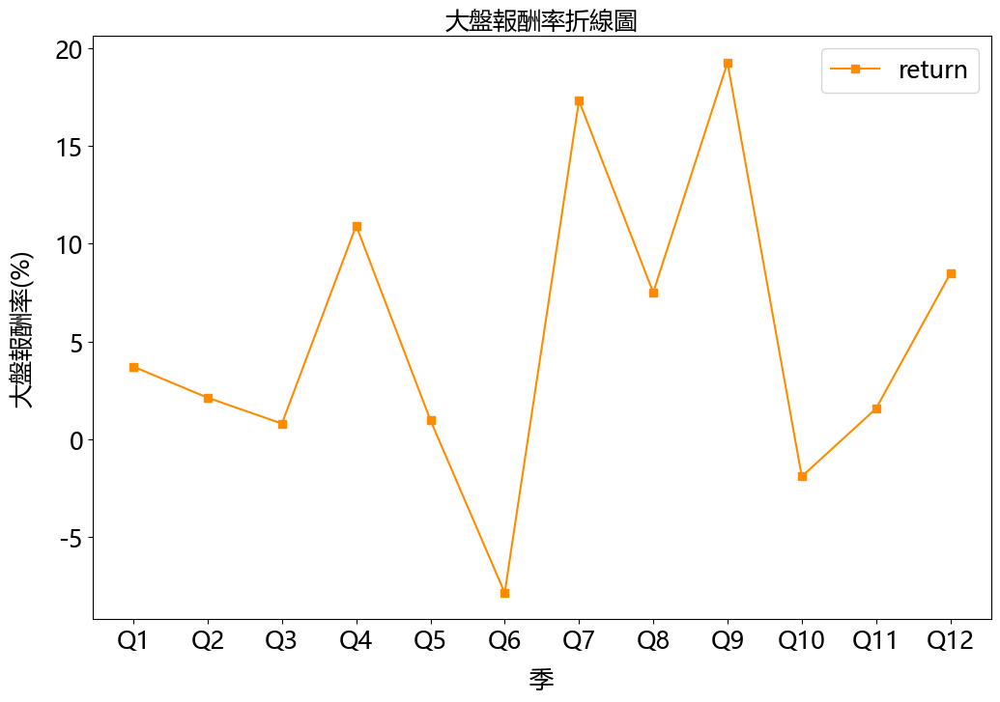

In [59]:
quarter = ['Q1', 'Q2', 'Q3', 'Q4','Q5','Q6','Q7','Q8','Q9','Q10','Q11','Q12']
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
plt.figure(figsize=(12,8),dpi=100,linewidth = 2)
plt.plot(quarter,c,'s-',color = 'darkorange', label="return")
plt.title(label='大盤報酬率折線圖', fontdict={'color': 'k', 'size': 18}, loc='center')
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.xlabel('季', fontsize=18, labelpad = 10)
plt.ylabel('大盤報酬率(%)', fontsize=18, labelpad = 15)
plt.legend(loc = "best", fontsize=18)
plt.show()

# 100家公司相對平均報酬率

In [60]:
company_return=[] 
for j in range(12):
    for i in range(100):
        stock_return = Y_test[(Table_1[11-j][i])*12+(11-j)]
        company_return.append(stock_return)
print(len(company_return))

1200


In [61]:
output_company_return=np.array(company_return).reshape(12,100)
print(output_company_return.ndim)
print(output_company_return.shape)
print(output_company_return.size)

2
(12, 100)
1200


In [62]:
all_average=[]
print(np.mean(output_company_return, axis=1))
all_average=np.mean(output_company_return, axis=1)
all_average

[ 0.03715113  0.00066793  0.0547067  -0.03567406  0.00490586  0.02831927
  0.02061402  0.00516195 -0.00591565  0.1782442   0.04887704  0.00048386]


array([ 0.03715113,  0.00066793,  0.0547067 , -0.03567406,  0.00490586,
        0.02831927,  0.02061402,  0.00516195, -0.00591565,  0.1782442 ,
        0.04887704,  0.00048386])

In [63]:
percent=[]
for i in range(12):
    percent.append(all_average[i]*100)
percent

[3.7151127022106585,
 0.0667928905214871,
 5.47066958844968,
 -3.567406249399981,
 0.49058573164941727,
 2.8319266267140097,
 2.0614015135723807,
 0.5161948578567119,
 -0.591564838599771,
 17.824419841917212,
 4.887703823733177,
 0.04838602449828472]

# 各區間平均相對報酬率 (每25名一組)

In [64]:
First_quarterly_return = []
Second_quarterly_return = []
Third_quarterly_return = []
Fourth_quarterly_return = []
for j in range (12):
    first_quarterly_return = 0
    second_quarterly_return = 0
    third_quarterly_return = 0
    fourth_quarterly_return = 0
    for i in range(25):
        first_quarterly_return+=Y_test[(Table_1[11-j][i])*12+(11-j)] 
    first_quarterly_return /=25 
    First_quarterly_return.append(first_quarterly_return)
    for i in range(25,50):
        second_quarterly_return+=Y_test[(Table_1[11-j][i])*12+(11-j)] 
    second_quarterly_return /=25 
    Second_quarterly_return.append(second_quarterly_return)
    for i in range(50,75):
        third_quarterly_return+=Y_test[(Table_1[11-j][i])*12+(11-j)] 
    third_quarterly_return /=25 
    Third_quarterly_return.append(third_quarterly_return)
    for i in range(75,100):
        fourth_quarterly_return+=Y_test[(Table_1[11-j][i])*12+(11-j)] 
    fourth_quarterly_return /=25 
    Fourth_quarterly_return.append(fourth_quarterly_return)
print(First_quarterly_return)

[array([0.05699704]), array([-0.00504534]), array([0.05069189]), array([-0.05029594]), array([0.02704081]), array([0.08287803]), array([0.07357132]), array([-0.02158567]), array([0.07712333]), array([0.18249787]), array([0.00941763]), array([0.03001089])]


# 總結果圖展現

In [65]:
def draw_return (return_array):
    return_array = np.array(return_array)
    return_array_list = return_array.tolist()
    QR = []
    for Return in return_array_list:
        QR.append(Return[0]*100)
    return QR  

In [66]:
FQR = draw_return(First_quarterly_return)
SQR = draw_return(Second_quarterly_return) 
TQR = draw_return(Third_quarterly_return) 
FFQR = draw_return(Fourth_quarterly_return) 

In [67]:
fqr = [1,1,1,1,1,1,1,1,1,1,1,1,1]
fqr_ab = fqr.copy()
for i in range(12):
    fqr[i+1] = fqr[i]*(1+First_quarterly_return[i])
    fqr_ab[i+1] = fqr_ab[i]*(1+First_quarterly_return[i]+start_in_2018[i])

In [68]:
for i in range (len(fqr)):
    fqr[i] = fqr[i]*100 - 100 
    fqr_ab[i] = fqr_ab[i]*100 - 100
print(fqr)
print(fqr_ab)

[0, array([5.69970448]), array([5.1664137]), array([10.49749793]), array([4.9399222]), array([7.77758232]), array([16.70997586]), array([25.29648316]), array([22.59187442]), array([32.04656775]), array([56.14478521]), array([57.6152994]), array([62.34547534])]
[0, array([9.41112974]), array([11.18521216]), array([17.7124506]), array([24.65135578]), array([29.23270759]), array([29.79678048]), array([61.81801316]), array([70.46551385]), array([116.43994958]), array([151.81771483]), array([158.13898893]), array([187.74979032])]


In [69]:
tw_date = below_end[:12]
tw_date_date = tw_date[::-1]
tw_test_return = []
tw_test_return_return = [0,1,1,1,1,1,1,1,1,1,1,1,1]
for date in tw_date_date: 
    tw_return_start = data_tw.loc['2018-08-20']
    start_value = tw_return_start['Close']
    tw_return_end = data_tw.loc[date]
    end_value = tw_return_end['Close']
    tw_test_return.append((end_value - start_value) / start_value)
print(tw_test_return)
for i in range (len(tw_test_return)):
    tw_test_return_return[i+1] = tw_test_return[i]*100
print(tw_test_return_return)

[-0.051106411227559545, -0.028099658747806077, -0.019655932865679605, 0.08947996349339944, 0.09905459441811193, 0.01508457554139911, 0.1943714518310667, 0.28258396194098356, 0.5273674000146223, 0.5078591511165702, 0.5305471691000597, 0.6654105618863825]
[0, -5.110641122755954, -2.8099658747806076, -1.9655932865679606, 8.947996349339943, 9.905459441811193, 1.508457554139911, 19.43714518310667, 28.258396194098356, 52.73674000146224, 50.78591511165702, 53.05471691000597, 66.54105618863825]


D:\Anaconda\lib\site-packages\numpy\core\_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)
D:\Anaconda\lib\site-packages\numpy\ma\core.py:2831: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  _data = np.array(data, dtype=dtype, copy=copy,


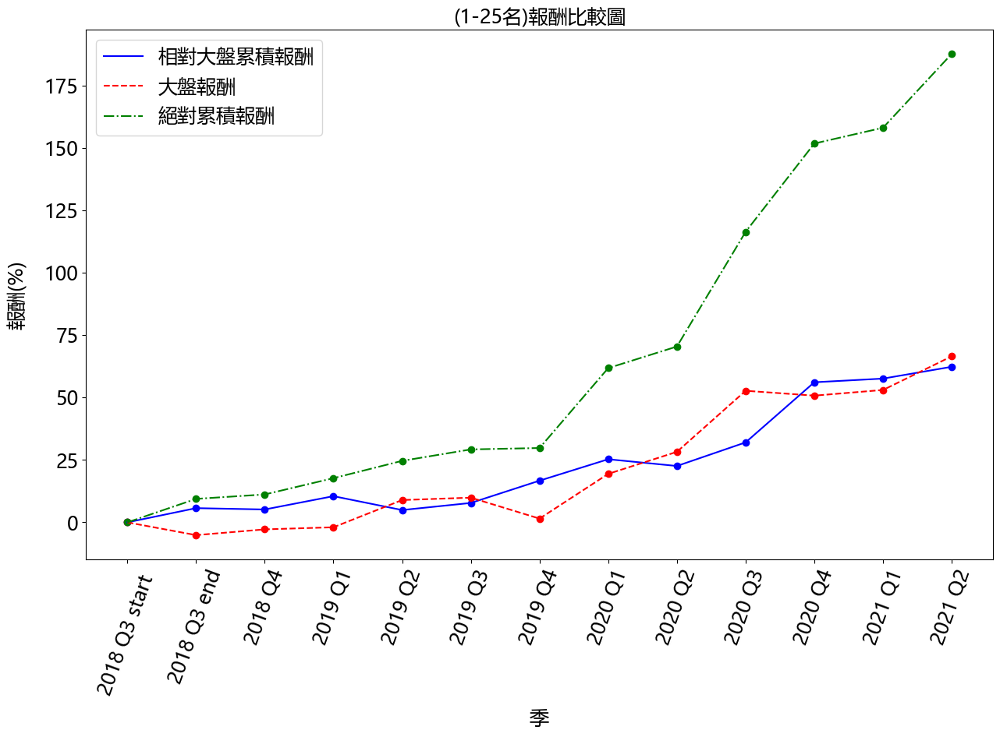

In [70]:
quarter= ['2018 Q3 start ', '2018 Q3 end', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 2)
plt.plot(quarter , fqr , color = 'blue', label="相對大盤累積報酬" )
plt.plot(quarter , tw_test_return_return , color = 'red', linestyle='--' , label="大盤報酬")
plt.plot(quarter , fqr_ab , color = 'green', linestyle='-.' , label="絕對累積報酬")
plt.title(label='(1-25名)報酬比較圖', fontdict={'color': 'k', 'size': 18}, loc='center')
plt.xticks(fontsize=18 , rotation = 70)
plt.yticks(fontsize=18)
plt.scatter(quarter , fqr , color = 'blue')
plt.scatter(quarter , tw_test_return_return , color = 'red')
plt.scatter(quarter , fqr_ab , color = 'green')
plt.xlabel('季', fontsize=18, labelpad = 10 )
plt.ylabel('報酬(%)', fontsize=18, labelpad = 15 )
plt.legend(loc = "best", fontsize=18)
plt.show()
fig.savefig('總結果比較.png')

In [71]:
fqr_return = 1
sqr_return = 1
tqr_return = 1
ffqr_return = 1
for i in range (12):
    fqr_return = fqr_return*(1+FQR[i]/100)
    sqr_return = sqr_return*(1+SQR[i]/100)
    tqr_return = tqr_return*(1+TQR[i]/100)
    ffqr_return = ffqr_return*(1+FFQR[i]/100)
print(fqr_return)
print(sqr_return)
print( tqr_return )
print(ffqr_return )

1.6234547534163914
1.170660726770899
1.2278745703375622
1.4513991126286272


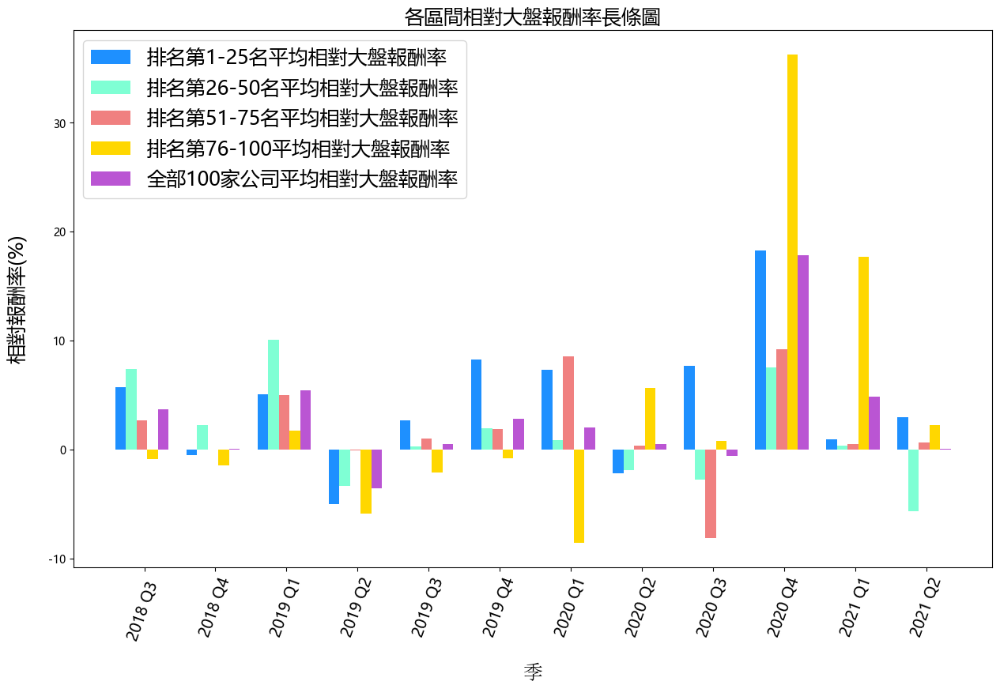

In [72]:
quarter = ['2018 Q3 ', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
y1 = FQR
y2 = SQR
y3 = TQR
y4 = FFQR
y5 = percent
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 3)
x_length = np.arange(len(quarter))
width = 0.15
plt.bar(x_length, y1, width, color='dodgerblue', label='排名第1-25名平均相對大盤報酬率')
plt.bar(x_length + width, y2, width, color='aquamarine', label='排名第26-50名平均相對大盤報酬率')
plt.bar(x_length + width*2, y3, width, color='lightcoral', label='排名第51-75名平均相對大盤報酬率')
plt.bar(x_length + width*3, y4, width, color='gold', label='排名第76-100平均相對大盤報酬率')
plt.bar(x_length + width*4, y5, width, color='mediumorchid', label='全部100家公司平均相對大盤報酬率')
plt.xticks(x_length + width / 0.45, quarter ,fontsize = 14, rotation = 70)
plt.title(label='各區間相對大盤報酬率長條圖', fontdict={ 'color': 'k', 'size': 18}, loc='center')
plt.xlabel('季', fontdict={'family': 'SimSun', 'color': 'k', 'size': 18}, labelpad=18)  
plt.ylabel('相對報酬率(%)', fontdict={'color': 'k', 'size': 18}, labelpad=18)  
plt.legend(loc='upper left', fontsize=18)
fig.savefig('各區間比較.png')

# HRP Portfolio

In [73]:
import ffn
import pypfopt
from pypfopt.hierarchical_portfolio import HRPOpt
from pypfopt.risk_models import risk_matrix

Annual volatility: 0.9%
Annual volatility: 0.7%
Annual volatility: 0.6%
Annual volatility: 0.6%
Annual volatility: 0.5%
Annual volatility: 0.6%
Annual volatility: 2.0%
Annual volatility: 0.8%
Annual volatility: 0.7%
Annual volatility: 0.7%
Annual volatility: 1.4%
Annual volatility: 0.7%
method 1: HRP with stock price
[]
method 2: HRP with return
[1.0409021173627644, 1.038135197038879, 1.0031584937194544, 1.0414976918665497, 1.0293145632829852, 1.0323876906912397, 1.2058318000625585, 1.0442200672176638, 1.2009789003274856, 1.1430638715795916, 0.9865702882997487, 1.0808154110103736]


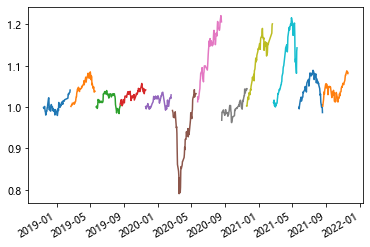

In [79]:
##季調整
import math
CO_count = 0 
check = 1
hrp_price_return_season = []
hrp_return_return_season = []
for i in range(11,-1,-1): ##12季
    date_col = []
    data_ret = pd.DataFrame()
    seasonal_co = []
    seasonal_co_top = []
    serach_date_parameter = []
    seasonal_co = result_table.iloc[:,CO_count]
    CO_count+=2
    for j in range (25):
        seasonal_co_top_name = seasonal_co[j][:4] 
        seasonal_co_top.append(seasonal_co_top_name) ##前30家公司
    for seasonal_co in seasonal_co_top:
        count = 0
        for Co in Co_array:
            if Co[:4] == seasonal_co:
                break
            else:
                count +=1
        serach_date_parameter = 54*count ##找出對應到 below_start 的起始位置
        search_co_parameter = seasonal_co +'.TW' ## 找 data_pv 的 CO_ID
        serach_date_start = below_start[serach_date_parameter + i+1]
        serach_date_end = below_end[serach_date_parameter + i]
        pv_target_co = data_pv.loc[data_pv['CO_ID'] == search_co_parameter]
        pv_target_date = pv_target_co[pv_target_co['Date'].between(serach_date_start,serach_date_end)]
        if len(date_col) == 0:
            date_col = pv_target_date.index
        temp_ret =  pv_target_date['Close'].values
        try :
            data_ret[seasonal_co] = pv_target_date['Close'].values
        except ValueError:
            if len(temp_ret) < len(data_ret):
                temp_len = len(data_ret) - len(temp_ret)
                for x in range(temp_len):
                    temp_ret = np.append(temp_ret , np.nan)
                data_ret[seasonal_co] = temp_ret
            if len(temp_ret) > len(data_ret):
                temp_len = len(temp_ret) - len(data_ret) 
                for x in range(temp_len):
                    temp_ret = np.delete(temp_ret, (len(temp_ret)-1)+x)
                data_ret[seasonal_co] = temp_ret
    data_ret = data_ret.set_index(date_col)
    if ((len(data_ret))%2) ==0 :
        data_ret = data_ret.drop(data_ret.index[0])
    date_col = data_ret.index
    ##----------------------------------------------------------------------------------------------------##
    
    ##開始 HRP
    data_ret_pct = data_ret.pct_change()
    portopt = HRPOpt(None, data_ret_pct.cov())
    weights = portopt.optimize() # optimize()計算權重
   
    ## Backtesting
    ndays = int (math.floor(((len(data_ret))/2)))# 每季調整一次資產
    
    # 用return原本的cov matrix
    eqs1 = pd.Series(dtype = 'float64')
    dates1 = date_col[::ndays] # 調整資產的日期
    weight_history1 = pd.DataFrame(columns=seasonal_co_top)
    for sdate, edate, fdate in zip(dates1, dates1[1:], dates1[2:]):
        daily_return = data_ret.loc[sdate:edate][seasonal_co_top].pct_change()
        portopt1 = HRPOpt(None, daily_return.cov())
        weights1 = portopt1.optimize() # 得到的weight是orderdictionary
        weight_history1.loc[edate] = pd.Series(weights1) # weight轉成時間序列，方便後面乘上日價格
        portopt1.portfolio_performance(verbose=True);

        future_daily_return =  data_ret.loc[edate:fdate][seasonal_co_top].pct_change()
        eq1 = (future_daily_return*weights1).dropna().sum(axis=1)
        eqs1 = eqs1.append(eq1) # 將eq存到eqs中
    s1 = (eqs1+1).cumprod() # 原本的eqs只是future daily return，現在要轉成累積報酬
    hrp_return_return_season.append(s1[-1])
    s1.plot()
    #weight_history
    check+=1
print('method 2: HRP with return')
print(hrp_return_return_season)

# 結果比較圖

In [75]:
hrp = [1,1,1,1,1,1,1,1,1,1,1,1,1]
for i in range(12):
    hrp[i+1] = hrp[i]*hrp_return_return_season[i]
print(hrp)

[1, 1.0409021173627644, 1.0805971247065798, 1.084010183938226, 1.1289941045314962, 1.162090073654902, 1.199727487515797, 1.4466695558557043, 1.5106413808573915, 1.8142484243713044, 2.073801827969037, 2.0459512672959588, 2.2112956598696765]


In [76]:
for i in range (len(hrp)):
    hrp[i] = hrp[i]*100 - 100 
print(hrp)

[0, 4.090211736276444, 8.05971247065797, 8.401018393822596, 12.899410453149613, 16.20900736549021, 19.9727487515797, 44.666955585570435, 51.06413808573916, 81.42484243713045, 107.38018279690368, 104.59512672959588, 121.12956598696763]


D:\Anaconda\lib\site-packages\numpy\core\_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)
D:\Anaconda\lib\site-packages\numpy\ma\core.py:2831: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  _data = np.array(data, dtype=dtype, copy=copy,
<ipython-input-77-0536591f187b>:17: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()


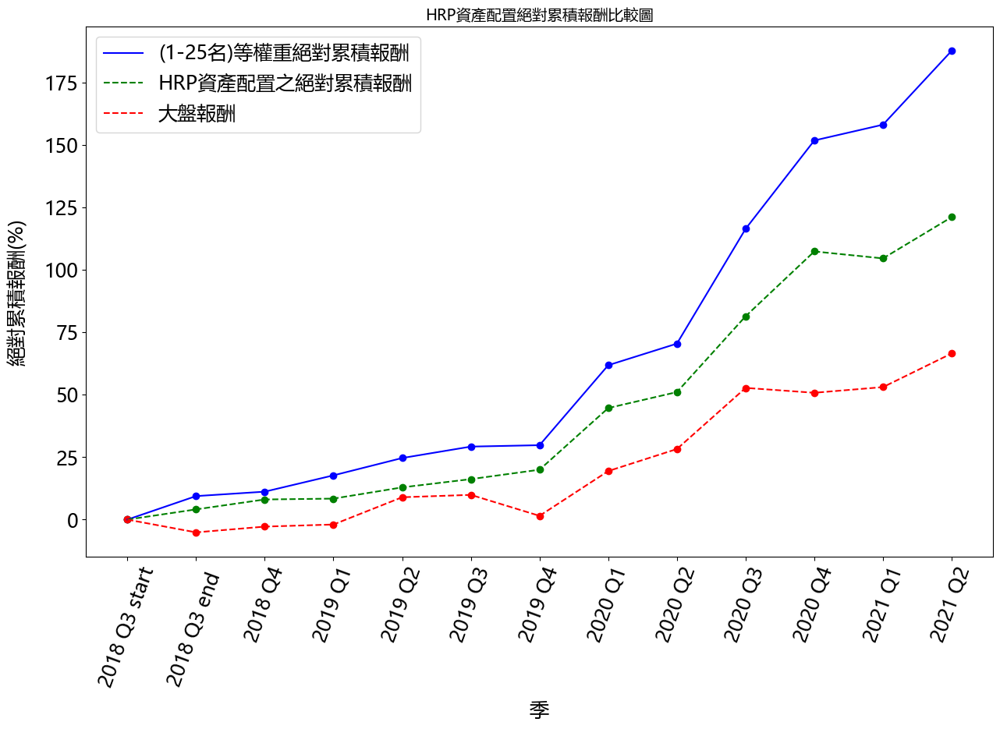

In [77]:
quarter = ['2018 Q3 start','2018 Q3 end ', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 2)
plt.plot(quarter , fqr_ab , color = 'blue', label="(1-25名)等權重絕對累積報酬")
plt.plot(quarter , hrp , color = 'green', linestyle='--' , label="HRP資產配置之絕對累積報酬")
plt.plot(quarter , tw_test_return_return , color = 'red', linestyle='--' , label="大盤報酬")
plt.title(label='HRP資產配置絕對累積報酬比較圖', fontdict={'color': 'k', 'size': 14}, loc='center')
plt.xticks(fontsize=18 , rotation = 70)
plt.yticks(fontsize=18)
plt.scatter(quarter , fqr_ab , color = 'blue')
plt.scatter(quarter , hrp , color = 'green')
plt.scatter(quarter , tw_test_return_return , color = 'red')
plt.xlabel('季', fontsize=18, labelpad = 10)
plt.ylabel('絕對累積報酬(%)', fontsize=18, labelpad = 15)
plt.legend(loc = "best", fontsize=18)
plt.show()
fig.savefig('hrp累積折線比較.png')

In [80]:
hrp_price_return_season_total_return = 1
hrp_return_return_season_total_return = 1
for i in range (12):
    hrp_return_return_season_total_return = hrp_return_return_season_total_return*hrp_return_return_season[i]
    hrp_return_return_season[i] = ((hrp_return_return_season[i] - start_in_2018[i]) *100)-100
    
print(hrp_return_return_season)
print(hrp_return_return_season_total_return)

[0.3787864755117738, 1.6875032725666301, -0.4855611089993914, -6.774617898032147, 1.9602044578940223, 11.090093481097838, 3.270029589004423, -3.080527111642027, 0.8402893225725876, 16.2108713885998, -2.91146583914211, -0.3882448147114843]
2.2112956598696765


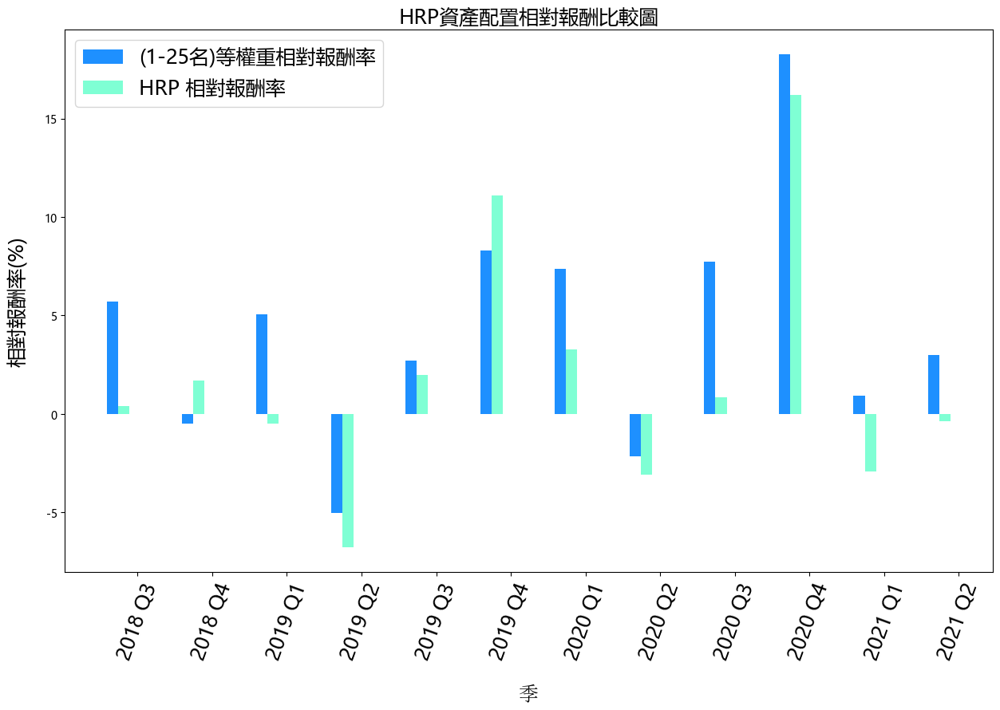

In [81]:
quarter = ['2018 Q3', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
y1 = FQR
y2 = hrp_return_return_season
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 3)
x_length = np.arange(len(quarter))
width = 0.15
plt.bar(x_length, y1, width, color='dodgerblue', label='(1-25名)等權重相對報酬率')
plt.bar(x_length + width, y2, width, color='aquamarine', label='HRP 相對報酬率')
plt.xticks(x_length + width / 0.45, quarter ,fontsize = 18 , rotation = 70)
plt.title(label='HRP資產配置相對報酬比較圖', fontdict={ 'color': 'k', 'size': 18}, loc='center')
plt.xlabel('季', fontdict={'family': 'SimSun', 'color': 'k', 'size': 18}, labelpad=14)  
plt.ylabel('相對報酬率(%)', fontdict={'color': 'k', 'size': 18}, labelpad=14)  
plt.legend(loc='upper left', fontsize=18)
fig.savefig('hrp相對長條圖比較.png')

# Markwiz portfolio

In [82]:
from pypfopt import risk_models
from pypfopt import plotting
from pypfopt import expected_returns
from pypfopt import EfficientFrontier
from pypfopt import CLA, plotting
from pypfopt import EfficientCVaR

In [83]:
import math
CO_count = 0 
check = 1 
company_weight=[]
company_weight_value=[]
for i in range(11,-1,-1): ##12季
    date_col = []
    data_ret = pd.DataFrame()
    seasonal_co = []
    seasonal_co_top = []
    serach_date_parameter = []
    seasonal_co = result_table.iloc[:,CO_count]
    CO_count+=2
    for j in range (25):
        seasonal_co_top_name = seasonal_co[j][:4] 
        seasonal_co_top.append(seasonal_co_top_name) ##前30家公司
        seasonal_co_top.sort()
    for seasonal_co in seasonal_co_top:
        count = 0
        for Co in Co_array:
            if Co[:4] == seasonal_co:
                break
            else:
                count +=1
        serach_date_parameter = 54*count ##找出對應到 below_start 的起始位置
        search_co_parameter = seasonal_co +'.TW' ## 找 data_pv 的 CO_ID
        serach_date_start = below_start[serach_date_parameter + i+1]
        serach_date_end = below_end[serach_date_parameter + i]
        pv_target_co = data_pv.loc[data_pv['CO_ID'] == search_co_parameter]
        pv_target_date = pv_target_co[pv_target_co['Date'].between(serach_date_start,serach_date_end)]
        if len(date_col) == 0:
            date_col = pv_target_date.index
        temp_ret =  pv_target_date['Close'].values
        try :
            data_ret[seasonal_co] = pv_target_date['Close'].values
        except ValueError:
            if len(temp_ret) < len(data_ret):
                temp_len = len(data_ret) - len(temp_ret)
                for x in range(temp_len):
                    temp_ret = np.append(temp_ret , np.nan)
                data_ret[seasonal_co] = temp_ret
            if len(temp_ret) > len(data_ret):
                temp_len = len(temp_ret) - len(data_ret) 
                for x in range(temp_len):
                    temp_ret = np.delete(temp_ret, (len(temp_ret)-1)+x)
                data_ret[seasonal_co] = temp_ret
    data_ret = data_ret.set_index(date_col)
    if ((len(data_ret))%2) ==0 :
        data_ret = data_ret.drop(data_ret.index[0])
    date_col = data_ret.index

 ##----------------------------------------------------------------------------------------------------##    
    
    ##開始 Markwiz(return)

    ndays = int (math.floor(((len(data_ret))/2)))
    dates = date_col[::ndays]   
    for sdate, edate, fdate in zip(dates, dates[1:], dates[2:]):
        test_return = data_ret.loc[sdate:edate][seasonal_co_top]
        test_return = test_return.dropna(how="all")
        S = risk_models.CovarianceShrinkage(test_return).ledoit_wolf()
        ef = EfficientFrontier(None, S, weight_bounds=(0, 1))
        ef.min_volatility()
        weights = ef.clean_weights()
        #print(weights)
        #print(weights.values())
        company_weight.append(weights)
        a=list(weights.values())
        company_weight_value.append(a)
        ef.portfolio_performance(verbose=True);

Annual volatility: 13.4%
Annual volatility: 9.7%
Annual volatility: 7.9%
Annual volatility: 8.2%
Annual volatility: 7.0%
Annual volatility: 8.7%
Annual volatility: 25.1%
Annual volatility: 10.7%
Annual volatility: 10.1%
Annual volatility: 10.9%
Annual volatility: 18.8%
Annual volatility: 10.2%


In [84]:
#拿來算等權重的風險
import math
CO_count = 0 
check = 1 
company_equal=[]
company_equal_value=[]
for i in range(11,-1,-1): ##12季
    date_col = []
    data_ret = pd.DataFrame()
    seasonal_co = []
    seasonal_co_top = []
    serach_date_parameter = []
    seasonal_co = result_table.iloc[:,CO_count]
    CO_count+=2
    for j in range (25):
        seasonal_co_top_name = seasonal_co[j][:4] 
        seasonal_co_top.append(seasonal_co_top_name) ##前30家公司
        seasonal_co_top.sort()
    for seasonal_co in seasonal_co_top:
        count = 0
        for Co in Co_array:
            if Co[:4] == seasonal_co:
                break
            else:
                count +=1
        serach_date_parameter = 54*count ##找出對應到 below_start 的起始位置
        search_co_parameter = seasonal_co +'.TW' ## 找 data_pv 的 CO_ID
        serach_date_start = below_start[serach_date_parameter + i+1]
        serach_date_end = below_end[serach_date_parameter + i]
        pv_target_co = data_pv.loc[data_pv['CO_ID'] == search_co_parameter]
        pv_target_date = pv_target_co[pv_target_co['Date'].between(serach_date_start,serach_date_end)]
        if len(date_col) == 0:
            date_col = pv_target_date.index
        temp_ret =  pv_target_date['Close'].values
        try :
            data_ret[seasonal_co] = pv_target_date['Close'].values
        except ValueError:
            if len(temp_ret) < len(data_ret):
                temp_len = len(data_ret) - len(temp_ret)
                for x in range(temp_len):
                    temp_ret = np.append(temp_ret , np.nan)
                data_ret[seasonal_co] = temp_ret
            if len(temp_ret) > len(data_ret):
                temp_len = len(temp_ret) - len(data_ret) 
                for x in range(temp_len):
                    temp_ret = np.delete(temp_ret, (len(temp_ret)-1)+x)
                data_ret[seasonal_co] = temp_ret
    data_ret = data_ret.set_index(date_col)
    if ((len(data_ret))%2) ==0 :
        data_ret = data_ret.drop(data_ret.index[0])
    date_col = data_ret.index

 ##----------------------------------------------------------------------------------------------------##    
    
    ##開始 Markwiz(return)

    ndays = int (math.floor(((len(data_ret))/2)))
    dates = date_col[::ndays]   
    for sdate, edate, fdate in zip(dates, dates[1:], dates[2:]):
        test_return = data_ret.loc[sdate:edate][seasonal_co_top]
        test_return = test_return.dropna(how="all")
        S = risk_models.CovarianceShrinkage(test_return).ledoit_wolf()
        ef = EfficientFrontier(None, S, weight_bounds=(0.04, 0.04))
        ef.min_volatility()
        weights = ef.clean_weights()
        #print(weights)
        #print(weights.values())
        company_equal.append(weights)
        a=list(weights.values())
        company_equal_value.append(a)
        ef.portfolio_performance(verbose=True);

Annual volatility: 19.6%
Annual volatility: 15.3%
Annual volatility: 11.1%
Annual volatility: 12.6%
Annual volatility: 8.6%
Annual volatility: 12.4%
Annual volatility: 34.3%
Annual volatility: 16.2%
Annual volatility: 13.4%
Annual volatility: 16.5%
Annual volatility: 28.2%
Annual volatility: 15.3%


In [85]:
company_weight_value_1=[] #從2020年開始的 #才能乘以 Ytest(從2021年開始的)
for k in range(12):
    company_weight_value_1.append(company_weight_value[11-k])
print(company_weight_value_1)

[[0.10629, 0.16268, 0.04815, 0.08355, 0.01086, 0.01879, 0.0, 0.06547, 0.03219, 0.0, 0.04179, 0.01832, 0.0681, 0.07613, 0.08769, 0.0, 0.0, 0.00347, 0.0, 0.06479, 0.0, 0.08845, 0.0182, 0.00508, 0.0], [0.10507, 0.14324, 0.06431, 0.0, 0.0, 0.0337, 0.05162, 0.0, 0.0, 0.00023, 0.10897, 0.19589, 0.0, 0.09903, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08197, 0.07381, 0.04217], [0.1697, 0.00319, 0.2128, 0.13447, 0.0258, 0.01255, 0.06722, 0.02394, 0.10735, 0.05414, 0.00801, 0.0, 0.0019, 0.01091, 0.0124, 0.00089, 0.0, 0.0, 0.0211, 0.0, 0.03671, 0.0, 0.01687, 0.08006, 0.0], [0.09877, 0.04623, 0.06502, 0.1684, 0.0, 0.0, 0.12374, 0.09423, 0.01251, 0.0, 0.0, 0.0214, 0.0, 0.03133, 0.0445, 0.0, 0.0, 0.05002, 0.01159, 0.07173, 0.05677, 0.03349, 0.07027, 0.0, 0.0], [0.10399, 0.12435, 0.0663, 0.0, 0.19309, 0.17012, 0.03899, 0.04046, 0.03744, 0.0, 0.05337, 0.03269, 0.00927, 0.0, 0.01816, 0.0, 0.0, 0.05114, 0.00729, 0.0, 0.0, 0.03316, 0.01561, 0.00459, 0.0], [0.03002, 0.0, 0.30255, 0.0, 0.39475, 0.0, 0.0, 0

In [86]:
Mean_Quarter_return=[]
stock_Quarterly_return_absolute = [1,1,1,1,1,1,1,1,1,1,1,1,1]
for i in range(12):
    quarterly_return=0
    for j in range(25):
        quarterly_return+=Y_test[(company_buy[i][j])*12+i]*company_weight_value_1[i][j]
    Mean_Quarter_return.append(quarterly_return)
        
stock_all_Quarterly_return=1 #相對複利季報酬率
stock_all_Quarterly_return_absolute=1 #絕對複利季報酬率

for i in range(12):
    stock_all_Quarterly_return*=(1+Mean_Quarter_return[i])  ##要減1
    stock_all_Quarterly_return_absolute = stock_all_Quarterly_return_absolute * (1+Mean_Quarter_return[i]+TW_return[i]) ##要減1
    stock_Quarterly_return_absolute[i+1] = stock_all_Quarterly_return_absolute
print(stock_Quarterly_return_absolute)

[1, array([1.09561259]), array([1.01650772]), array([1.1671958]), array([1.37186924]), array([1.46135556]), array([1.53795104]), array([1.47725394]), array([1.55607564]), array([1.63493252]), array([1.7177386]), array([1.7360089]), array([1.79896388])]


In [87]:
Mean_Quarter_return_1=np.flip(Mean_Quarter_return)#倒過來從2018開始
print(Mean_Quarter_return_1)#從2018年開始的
print('相對累積報酬率',stock_all_Quarterly_return)
print('絕對累積報酬率',stock_all_Quarterly_return_absolute)

[[-0.00085005]
 [-0.01062391]
 [ 0.0426339 ]
 [-0.0585671 ]
 [ 0.04364439]
 [ 0.03904704]
 [-0.12071752]
 [-0.00979585]
 [-0.01722116]
 [ 0.1672858 ]
 [-0.08788644]
 [ 0.01091473]]
相對累積報酬率 [0.96905994]
絕對累積報酬率 [1.79896388]


In [88]:
mark = [1,1,1,1,1,1,1,1,1,1,1,1,1]
for i in range(12):
    mark[i+1] = mark[i]*(1 + Mean_Quarter_return_1[i])
print(mark)

[1, array([0.99914995]), array([0.98853507]), array([1.03068018]), array([0.97031623]), array([1.01266508]), array([1.05220665]), array([0.92518688]), array([0.91612388]), array([0.90034717]), array([1.05096247]), array([0.95859711]), array([0.96905994])]


In [89]:
for i in range (len(stock_Quarterly_return_absolute)):
    stock_Quarterly_return_absolute[i] = stock_Quarterly_return_absolute[i]*100 - 100 
print(stock_Quarterly_return_absolute)

[0, array([9.56125879]), array([1.65077204]), array([16.71957994]), array([37.18692416]), array([46.13555648]), array([53.79510366]), array([47.72539408]), array([55.60756397]), array([63.49325214]), array([71.77385956]), array([73.60088995]), array([79.89638845])]


In [90]:
for i in range (len(mark)):
    mark[i] =mark[i]*100 - 100 
print(mark)

[0, array([-0.08500462]), array([-1.14649258]), array([3.06801821]), array([-2.96837717]), array([1.2665085]), array([5.2206655]), array([-7.48131199]), array([-8.38761154]), array([-9.96528305]), array([5.0962467]), array([-4.14028852]), array([-3.09400578])]


In [91]:
mean_variance = draw_return(Mean_Quarter_return_1) 
print(mean_variance)

[-0.08500462325313428, -1.0623910412788475, 4.263390243690141, -5.8567104383491735, 4.364438671874094, 3.904703597961838, -12.07175170800496, -0.9795853984815863, -1.7221158935624168, 16.728580108743234, -8.788644234785952, 1.091472870633123]


D:\Anaconda\lib\site-packages\numpy\core\_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)
D:\Anaconda\lib\site-packages\numpy\ma\core.py:2831: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  _data = np.array(data, dtype=dtype, copy=copy,
<ipython-input-92-306343d4557d>:17: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()


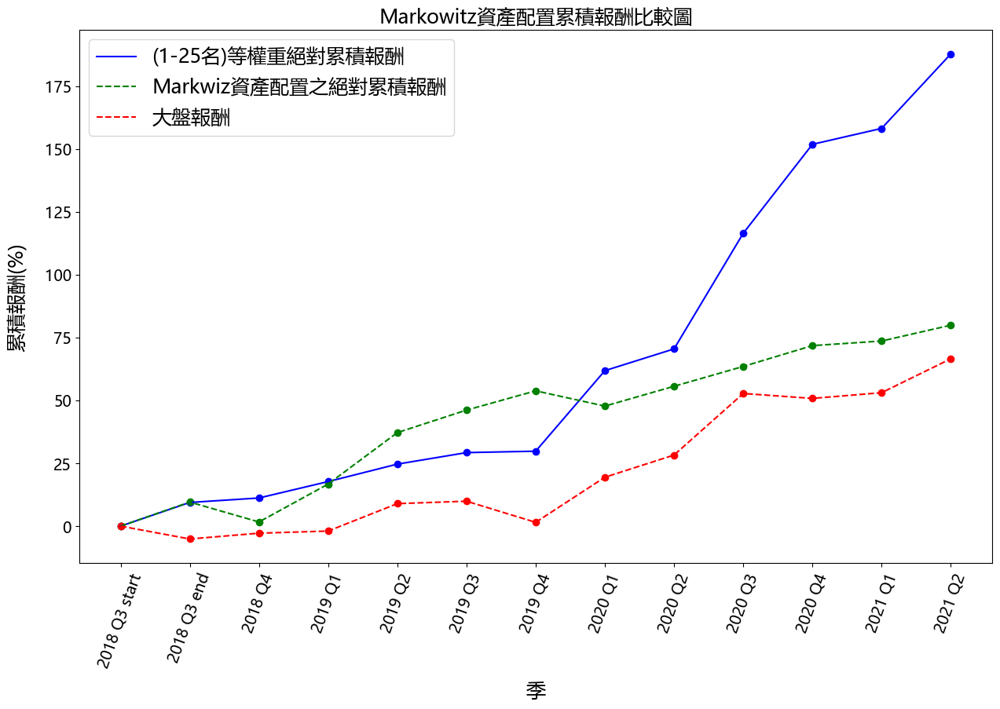

In [92]:
quarter = ['2018 Q3 start', '2018 Q3 end','2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 2)
plt.plot(quarter , fqr_ab , color = 'blue', label="(1-25名)等權重絕對累積報酬")
plt.plot(quarter , stock_Quarterly_return_absolute , color = 'green', linestyle='--' , label="Markwiz資產配置之絕對累積報酬")
plt.plot(quarter , tw_test_return_return , color = 'red', linestyle='--' , label="大盤報酬")
plt.title(label='Markowitz資產配置累積報酬比較圖', fontdict={'color': 'k', 'size': 18}, loc='center')
plt.xticks(fontsize=14 , rotation = 70)
plt.yticks(fontsize=14)
plt.scatter(quarter , fqr_ab , color = 'blue')
plt.scatter(quarter , stock_Quarterly_return_absolute , color = 'green')
plt.scatter(quarter , tw_test_return_return , color = 'red')
plt.xlabel('季', fontsize=18, labelpad = 10)
plt.ylabel('累積報酬(%)', fontsize=18, labelpad = 15)
plt.legend(loc = "best", fontsize=18)
plt.show()
fig.savefig('Markwiz累積折線比較.png')

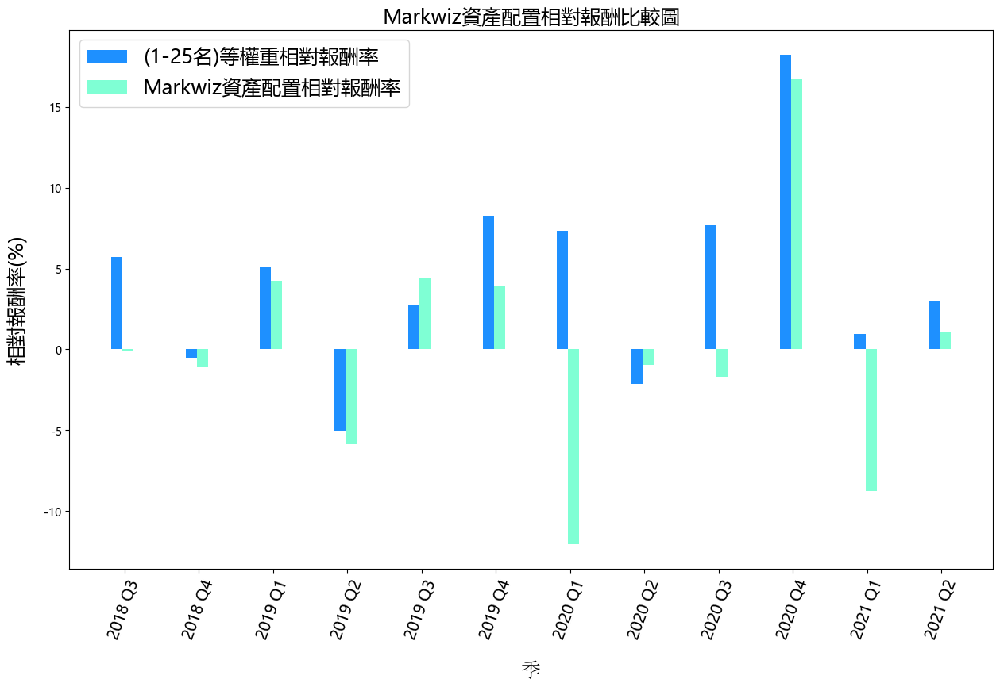

In [93]:
quarter = ['2018 Q3', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
y1 = FQR
y2 = mean_variance
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 3)
x_length = np.arange(len(quarter))
width = 0.15
plt.bar(x_length, y1, width, color='dodgerblue', label='(1-25名)等權重相對報酬率')
plt.bar(x_length + width, y2, width, color='aquamarine', label='Markwiz資產配置相對報酬率')
plt.xticks(x_length + width / 1.5, quarter ,fontsize = 14 , rotation = 70)
plt.title(label='Markwiz資產配置相對報酬比較圖', fontdict={ 'color': 'k', 'size': 18}, loc='center')
plt.xlabel('季', fontdict={'family': 'SimSun', 'color': 'k', 'size': 18}, labelpad=14)  
plt.ylabel('相對報酬率(%)', fontdict={'color': 'k', 'size': 18}, labelpad=14)  
plt.legend(loc='upper left', fontsize=18)
fig.savefig('Markwiz相對長條圖比較.png')

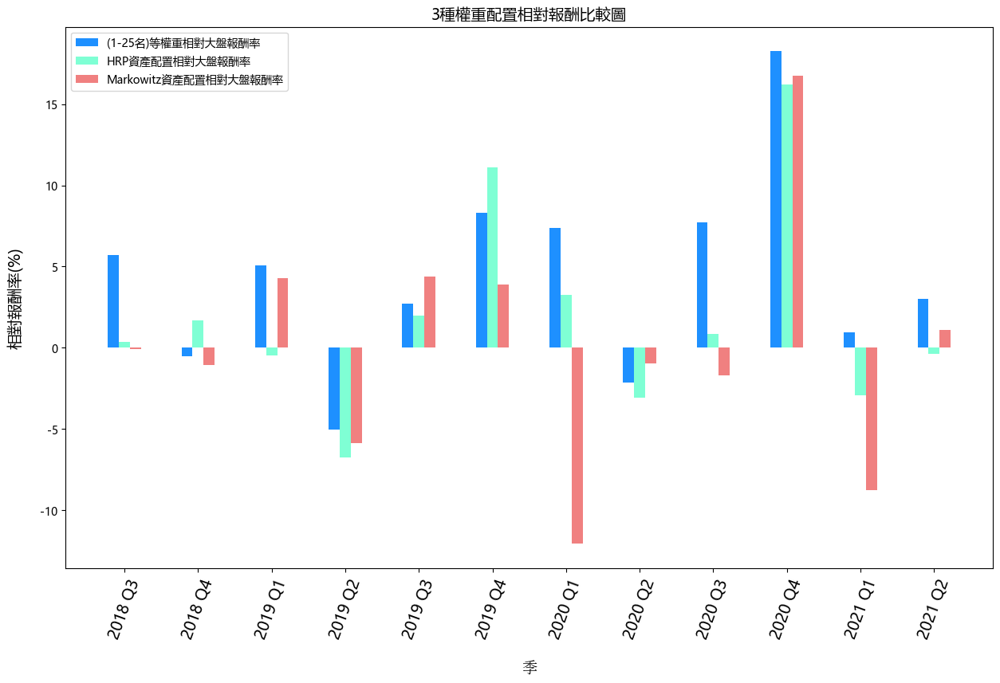

In [94]:
quarter = ['2018 Q3', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
y1 = FQR
y2 = hrp_return_return_season
y3 = mean_variance
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 3)
x_length = np.arange(len(quarter))
width = 0.15
plt.bar(x_length, y1, width, color='dodgerblue', label='(1-25名)等權重相對大盤報酬率')
plt.bar(x_length + width, y2, width, color='aquamarine', label='HRP資產配置相對大盤報酬率')
plt.bar(x_length + width*2, y3, width, color='lightcoral', label='Markowitz資產配置相對大盤報酬率')
plt.xticks(x_length + width / 1, quarter ,fontsize = 14 , rotation = 70)
plt.title(label='3種權重配置相對報酬比較圖', fontdict={ 'color': 'k', 'size': 14}, loc='center')
plt.xlabel('季', fontdict={'family': 'SimSun', 'color': 'k', 'size': 14}, labelpad=14)  
plt.ylabel('相對報酬率(%)', fontdict={'color': 'k', 'size': 14}, labelpad=14)  
plt.legend(loc='upper left', fontsize=10)
fig.savefig('全部相對長條圖比較.png')

<ipython-input-95-75ad5da85a58>:17: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()


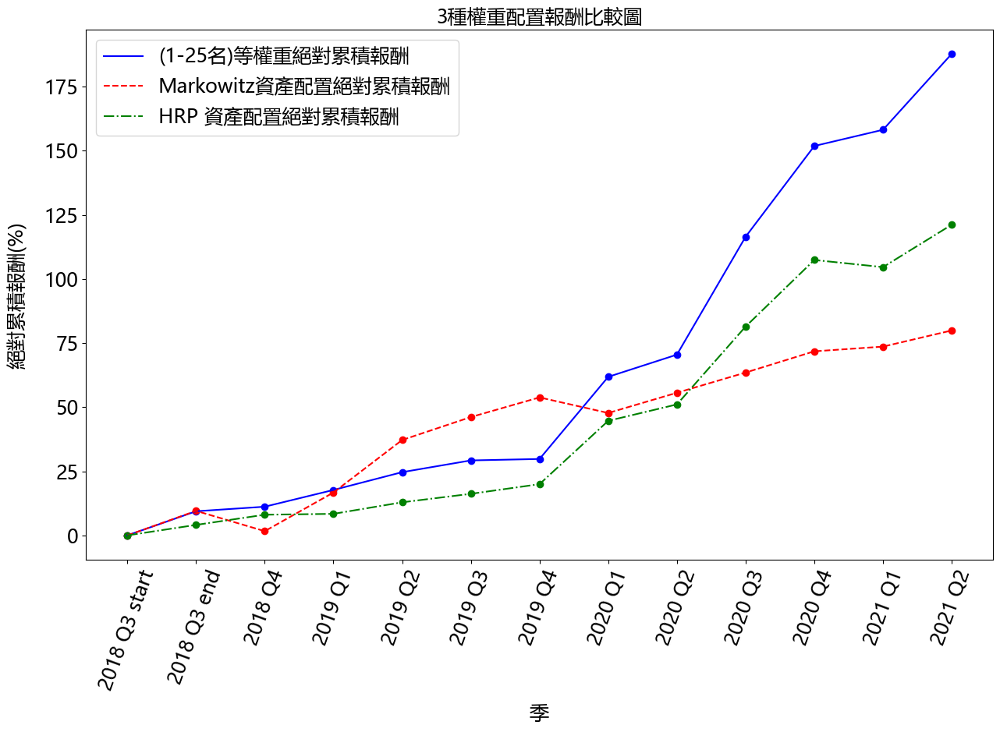

In [95]:
quarter = ['2018 Q3 start', '2018 Q3 end','2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 2)
plt.plot(quarter , fqr_ab , color = 'blue', label="(1-25名)等權重絕對累積報酬")
plt.plot(quarter , stock_Quarterly_return_absolute , color = 'red', linestyle='--' , label="Markowitz資產配置絕對累積報酬")
plt.plot(quarter , hrp , color = 'green', linestyle='-.' , label="HRP 資產配置絕對累積報酬")
plt.title(label='3種權重配置報酬比較圖', fontdict={'color': 'k', 'size': 18}, loc='center')
plt.xticks(fontsize=18 , rotation = 70)
plt.yticks(fontsize=18)
plt.scatter(quarter , fqr_ab , color = 'blue')
plt.scatter(quarter , stock_Quarterly_return_absolute , color = 'red')
plt.scatter(quarter , hrp , color = 'green')
plt.xlabel('季', fontsize=18, labelpad = 10)
plt.ylabel('絕對累積報酬(%)', fontsize=18, labelpad = 15)
plt.legend(loc = "best", fontsize=18)
plt.show()
fig.savefig('全部累積折線比較.png')

# 手續費

In [96]:
## 等權重
CO_count = 0 
check = 0
return_array = []
for i in range(11,-1,-1): ##12季
    date_col = []
    data_ret = pd.DataFrame()
    seasonal_co = []
    seasonal_co_top = []
    serach_date_parameter = []
    seasonal_co = result_table.iloc[:,CO_count]
    CO_count+=2
    target_return = 0
    for j in range (25):
        seasonal_co_top_name = seasonal_co[j][:4] 
        seasonal_co_top.append(seasonal_co_top_name) ##前30家公司
        seasonal_co_top.sort()
    for seasonal_co in seasonal_co_top:
        count = 0
        for Co in Co_array:
            if Co[:4] == seasonal_co:
                break
            else:
                count +=1
        serach_date_parameter = 54*count ##找出對應到 below_start 的起始位置
        search_co_parameter = seasonal_co +'.TW' ## 找 data_pv 的 CO_ID
        serach_date_start = below_start[serach_date_parameter + i]
        serach_date_end = below_end[serach_date_parameter + i]
        pv_target_co = data_pv.loc[data_pv['CO_ID'] == search_co_parameter]
        pv_target_date_start = pv_target_co[pv_target_co['Date'] == serach_date_start]
        pv_target_date_end = pv_target_co[pv_target_co['Date'] == serach_date_end]
        tw_target_date_start = data_tw[data_tw['Date'] == serach_date_start]
        tw_target_date_end = data_tw[data_tw['Date'] == serach_date_end]
        target_price_start =  pv_target_date_start['Close'].values
        target_price_end = pv_target_date_end['Close'].values
        tw_price_start =  tw_target_date_start['Close'].values
        tw_price_end = tw_target_date_end['Close'].values
        transaction_fee_start = target_price_start * 0.001425
        transaction_fee_end = target_price_end * 0.001425
        if transaction_fee_start < 0.02:
            transaction_fee_start = 0.02
        if transaction_fee_end < 0.02:
            transaction_fee_end = 0.02
        tax_start = target_price_start * 0.003
        tax_end = target_price_end * 0.003
        target_price_start = target_price_start + tax_start + transaction_fee_start
        target_price_end = target_price_end - tax_end - transaction_fee_end
        target_return = target_return + (((target_price_end - target_price_start) / target_price_start)/25)
        tww_return = (tw_price_end - tw_price_start) / tw_price_start
    target_return = target_return - tww_return
    return_array.append(target_return)
print(return_array)


[array([0.04401809]), array([-0.00773726]), array([0.04528416]), array([-0.05579866]), array([0.02111171]), array([0.07111438]), array([0.06958283]), array([-0.01632261]), array([0.05376]), array([0.1612672]), array([0.01544268]), array([0.0156331])]


In [97]:
return_array = draw_return(return_array) 
print(return_array)

[4.401809166465919, -0.7737262907847027, 4.528416435023817, -5.579865906489009, 2.1111706427290877, 7.111437836919291, 6.958282921200018, -1.6322613477154233, 5.375999886697366, 16.1267203311486, 1.544267642748287, 1.563309641683544]


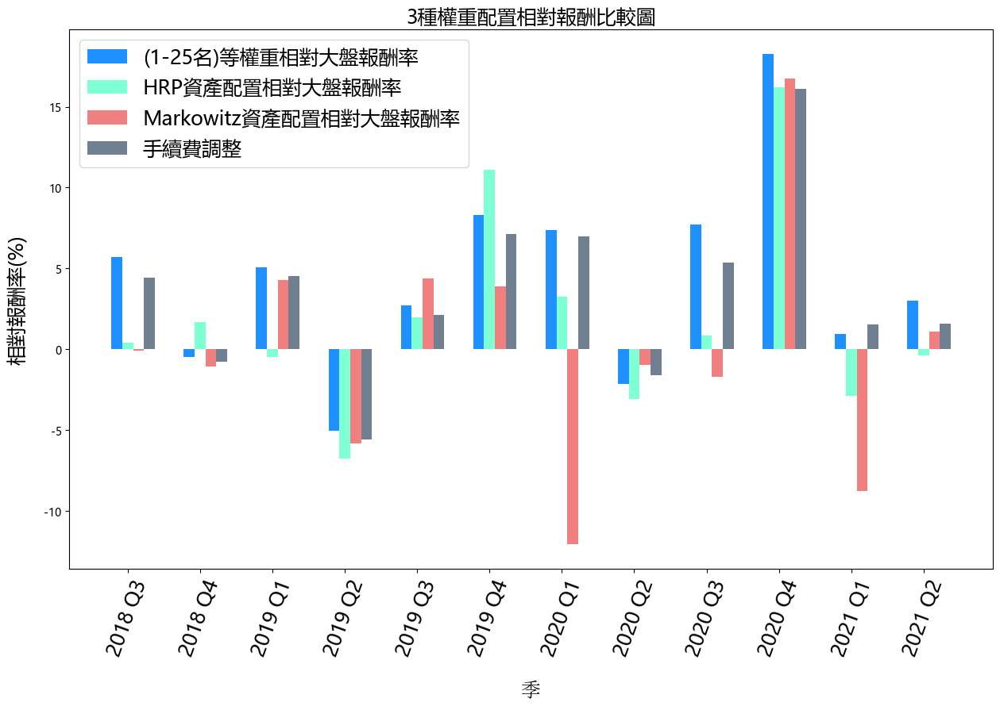

In [98]:
quarter = ['2018 Q3', '2018 Q4', '2019 Q1', '2019 Q2','2019 Q3','2019 Q4','2020 Q1','2020 Q2','2020 Q3','2020 Q4',' 2021 Q1','2021 Q2']
y1 = FQR
y2 = hrp_return_return_season
y3 = mean_variance
y4 = return_array
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False
fig = plt.figure(figsize=(15,9),dpi=100,linewidth = 4)
x_length = np.arange(len(quarter))
width = 0.15
plt.bar(x_length, y1, width, color='dodgerblue', label='(1-25名)等權重相對大盤報酬率')
plt.bar(x_length + width, y2, width, color='aquamarine', label='HRP資產配置相對大盤報酬率')
plt.bar(x_length + width*2, y3, width, color='lightcoral', label='Markowitz資產配置相對大盤報酬率')
plt.bar(x_length + width*3, y4, width, color='slategray', label='手續費調整')
plt.xticks(x_length + width / 1, quarter ,fontsize = 18 , rotation = 70)
plt.title(label='3種權重配置相對報酬比較圖', fontdict={ 'color': 'k', 'size': 18}, loc='center')
plt.xlabel('季', fontdict={'family': 'SimSun', 'color': 'k', 'size': 18}, labelpad=14)  
plt.ylabel('相對報酬率(%)', fontdict={'color': 'k', 'size': 18}, labelpad=14)  
plt.legend(loc='upper left', fontsize=18)
fig.savefig('全部相對長條圖比較3.png')